
# Train YOLOv12 Object detect behavior

---

[![Colab](https://colab.research.google.com/assets/colab-badge.svg)](https://colab.research.google.com/github/roboflow-ai/notebooks/blob/main/notebooks/train-yolov12-object-detection-model.ipynb)
[![arXiv](https://img.shields.io/badge/arXiv-2502.12524-b31b1b.svg)](https://arxiv.org/abs/2502.12524)
[![Roboflow](https://raw.githubusercontent.com/roboflow-ai/notebooks/main/assets/badges/roboflow-blogpost.svg)](https://blog.roboflow.com/train-yolov12-model)
[![GitHub](https://badges.aleen42.com/src/github.svg)](https://github.com/sunsmarterjie/yolov12)

[YOLOv12](https://github.com/sunsmarterjie/yolov12) is a newly proposed attention-centric variant of the YOLO family that focuses on incorporating efficient attention mechanisms into the backbone while preserving real-time performance. Instead of relying heavily on CNN-based architectures like its predecessors, YOLOv12 introduces a simple yet powerful “area attention” module, which strategically partitions the feature map to reduce the quadratic complexity of full self-attention. It also adopts residual efficient layer aggregation networks (R-ELAN) to enhance feature aggregation and training stability, especially for larger models. These innovations, together with refinements such as scaled residual connections and a reduced MLP ratio, enable YOLOv12 to harness the benefits of attention (e.g., better global context modeling) without sacrificing speed.

![yolov12-area-attention](https://media.roboflow.com/notebooks/examples/yolov12-area-attention.png)

Compared to prior YOLO iterations (e.g., YOLOv10, YOLOv11, and YOLOv8), YOLOv12 achieves higher detection accuracy with competitive or faster inference times across all model scales. Its five sizes—N, S, M, L, and X—range from 2.6M to 59.1M parameters, striking a strong accuracy–speed balance. For instance, the smallest YOLOv12-N surpasses other “nano” models by over 1% mAP with latency around 1.6 ms on a T4 GPU, and the largest YOLOv12-X achieves 55.2% mAP, comfortably outscoring comparable real-time detectors such as RT-DETR and YOLOv11-X . By matching or exceeding state-of-the-art accuracy while remaining fast, YOLOv12 represents a notable step forward for attention-based real-time object detection.

![yolov12-metrics](https://storage.googleapis.com/com-roboflow-marketing/notebooks/examples/yolov12-metrics.png)

- Latancy là thời gian chễ. Nếu càng thấp thì model tốt
- FLOPs là số lượng ghép dấu chấm động mà mô hình thực hiện để
xử lý ảnh. Chỉ số này thể hiện mức độ phức tạp của mô hình
- Ms COCO mAP độ chính xác trung bình ngưỡng

## 1. Introduction and Environment setup

### 1.1 Kiến trúc YOLOv12

* Tham chieu:

### 1.2 Check GPU availability

**NOTE:** **YOLOv12 leverages FlashAttention to speed up attention-based computations, but this feature requires an Nvidia GPU built on the Ampere architecture or newer—for example, GPUs like the RTX 3090, RTX 3080, or even the Nvidia L4 meet this requirement.**

Let's make sure that we have access to GPU. We can use `nvidia-smi` command to do that. In case of any problems navigate to `Edit` -> `Notebook settings` -> `Hardware accelerator`, set it to `GPU`, and then click `Save`.

In [1]:
!nvidia-smi

Thu Mar 27 13:38:49 2025       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.216.01             Driver Version: 535.216.01   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  NVIDIA A30                     Off | 00000000:D8:00.0 Off |                    0 |
| N/A   44C    P0              35W / 165W |  11317MiB / 24576MiB |      6%      Default |
|                                         |                      |             Disabled |
+-----------------------------------------+----------------------+--

In [2]:
import torch
print("CUDA Available:", torch.cuda.is_available())
print("Torch Version:", torch.__version__)
print("GPU Name:", torch.cuda.get_device_name(0) if torch.cuda.is_available() else "No GPU detected")


CUDA Available: True
Torch Version: 2.6.0+cu118
GPU Name: NVIDIA A30


### 1.3 Kết nối tới google drive tải flash-attn

In [3]:
!pip install flash-attn --only-binary :all:

Defaulting to user installation because normal site-packages is not writeable
ERROR: Could not find a version that satisfies the requirement flash-attn (from versions: none)
ERROR: No matching distribution found for flash-attn


### 1.4 Clone ngay tại thư mục đang làm việc ( Git, flash-attn roboflow)

In [5]:
!pip install roboflow supervision flash-attn

Defaulting to user installation because normal site-packages is not writeable
  Cloning https://github.com/sunsmarterjie/yolov12.git to /tmp/pip-req-build-y590waiz
  Running command git clone --filter=blob:none --quiet https://github.com/sunsmarterjie/yolov12.git /tmp/pip-req-build-y590waiz
  Resolved https://github.com/sunsmarterjie/yolov12.git to commit a36c50bb192846002958010da2eae9b39f920050
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
  Using cached flash_attn-2.7.4.post1.tar.gz (6.0 MB)
  Preparing metadata (setup.py) ... error
  error: subprocess-exited-with-error
  
  × python setup.py egg_info did not run successfully.
  │ exit code: 1
  ╰─> [11 lines of output]
      
      
      torch.__version__  = 2.6.0+cu118
      
      
      Traceback (most recent call last):
        File "<string>", line 2, in <module>
        File "<pip-setuptools-caller>", line 34, in <module>
        File "/t

#### 1.4.1  Download dataset from Roboflow Universe

In [23]:
pip install flash-attn==2.0.2

Defaulting to user installation because normal site-packages is not writeable
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.2/4.2 MB 9.0 MB/s eta 0:00:00a 0:00:01
  Preparing metadata (setup.py) ... done
  error: subprocess-exited-with-error
  
  × python setup.py bdist_wheel did not run successfully.
  │ exit code: 1
  ╰─> [4684 lines of output]
      
      
      torch.__version__  = 2.6.0+cu118
      
      
      fatal: not a git repository (or any of the parent directories): .git
      running bdist_wheel
      running build
      running build_py
      creating build/lib.linux-x86_64-cpython-312/flash_attn
      copying flash_attn/flash_attn_interface.py -> build/lib.linux-x86_64-cpython-312/flash_attn
      copying flash_attn/flash_attn_triton.py -> build/lib.linux-x86_64-cpython-312/flash_attn
      copying flash_attn/flash_attn_triton_og.py -> build/lib.linux-x86_64-cpython-312/flash_attn
      copying flash_attn/flash_attn_triton_tmp.py -> build/lib.linux-x86_64-cpython-31

In [6]:
import os
print(os.getcwd())

/hdd2/minhnv/CodingYOLOv12/Behavior-Detect-Student-YOLO/DataPreprocessing


## 2. Thống kê ảnh
- Thống kê về phân bổ số lượng object file train, valid, test
- Thống kê số lượng theo lớp
- Thống kê kích thước ảnh

### 2.1 Data yaml path

- Student-Behavior-Recognition-2 : Version ngày 11-03-2025 có những bức ảnh using computer chỉ gán mỗi tay không gán cả người

In [7]:
data_yaml_path = "/hdd2/minhnv/CodingYOLOv12/Dataset/Student-Behavior-Recognition-6/data.yaml"

#### 2.1.1 Hàm lấy đường dẫn duy nhất ( Quy tắc đường dẫn )

In [4]:
from datetime import datetime
import os
def get_unique_path(base_path):
    """
    Tạo đường dẫn duy nhất bằng cách thêm phiên bản nếu thư mục đã tồn tại

    Args:
        base_path (str): Đường dẫn gốc muốn tạo

    Returns:
        str: Đường dẫn duy nhất
    """
    # Nếu thư mục chưa tồn tại, trả về ngay
    if not os.path.exists(base_path):
        return f"{base_path}_ver{1}"

    # Nếu đã tồn tại, tìm phiên bản tiếp theo
    version = 2
    while True:
        versioned_path = f"{base_path}_ver{version}"
        if not os.path.exists(versioned_path):
            return versioned_path
        version += 1
        
# Tạo đường dẫn lưu trữ với thư mục theo ngày
current_date = datetime.now().strftime("%d%m%Y_%H%M%S")
nameYoloFamily = 'yolov12s'
### base
ver_dataset = 6
base_save_path = f'/hdd2/minhnv/CodingYOLOv12/Behavior-Detect-Student-YOLO/StaticModels/{nameYoloFamily}{current_date}_ver-dataset{ver_dataset}/'
print(f'Base path: {base_save_path}')
# Lấy đường dẫn duy nhất ----------------------------------Đường dẫn này cũng là quan trọng. Vì các báo cáo dưới đều càn đến
unique_save_path = get_unique_path(base_save_path)
# Tạo thư mục
os.makedirs(unique_save_path, exist_ok=True)

Base path: /hdd2/minhnv/CodingYOLOv12/Behavior-Detect-Student-YOLO/StaticModels/yolov12s19032025_154554_ver-dataset6/


### 2.2.0 Thống kê số bức ảnh

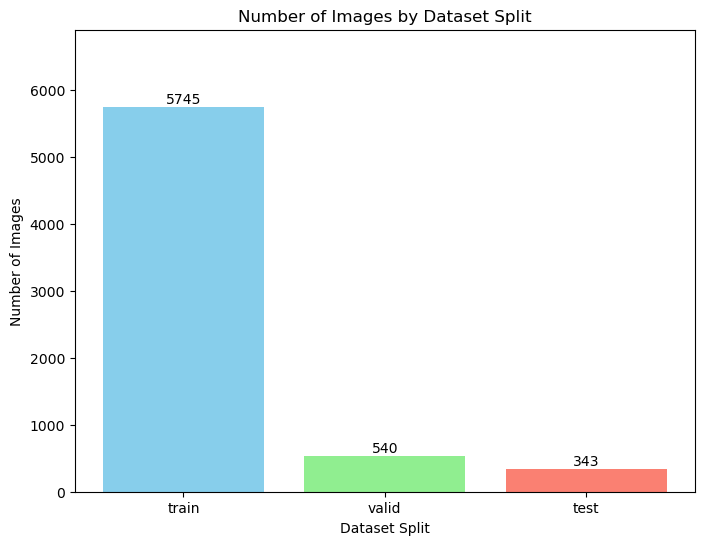

In [12]:
import os
import matplotlib.pyplot as plt

def count_images(root_dir):
    """
    Count the number of images in the 'train', 'valid', and 'test' folders 
    (in the 'images' subdirectory).
    Returns a dictionary with the image count for each split.
    """
    splits = ['train', 'valid', 'test']
    counts = {}
    
    for split in splits:
        img_dir = os.path.join(root_dir, split, 'images')
        if not os.path.exists(img_dir):
            print(f"Directory not found: {img_dir}")
            counts[split] = 0
            continue
        
        # Filter image files with appropriate extensions
        images = [f for f in os.listdir(img_dir) if f.lower().endswith(('.png', '.jpg', '.jpeg'))]
        counts[split] = len(images)
    
    return counts

def visualize_image_counts(root_dir):
    """
    Display a bar chart showing the number of images for each dataset split.
    """
    counts = count_images(root_dir)
    splits = list(counts.keys())
    values = [counts[split] for split in splits]
    
    plt.figure(figsize=(8, 6))
    bars = plt.bar(splits, values, color=['skyblue', 'lightgreen', 'salmon'])
    
    plt.title("Number of Images by Dataset Split")
    plt.xlabel("Dataset Split")
    plt.ylabel("Number of Images")
    plt.ylim(0, max(values) * 1.2)

    # Annotate each bar with its count
    for bar in bars:
        yval = bar.get_height()
        plt.text(bar.get_x() + bar.get_width() / 2, yval + 1, int(yval), ha='center', va='bottom')
    plt.show()

if __name__ == '__main__':
    dataset_root = "/hdd2/minhnv/CodingYOLOv12/Dataset/Student-Behavior-Recognition-6_oversampled"  # Update this path to your dataset directory
    visualize_image_counts(dataset_root)


### 2.2 Thống kê số lượng đối tượng và kích thước ảnh ( Chưa lưu vào folder)

1. Đọc file YAML:

Classes: ['sleeping', 'using_computer', 'using_phone', 'writing', 'hand-raising', 'read', 'write']

2. Cấu trúc thư mục:
Root path: /hdd2/minhnv/CodingYOLOv12/Dataset/Student-Behavior-Recognition-6
Nội dung root:
['data.yaml', 'train', 'test', 'invalid_files', 'README.dataset.txt', 'README.roboflow.txt', 'valid']

Mẫu nội dung labels:
4 0.729324414715719 0.664179 0.1423768115942029 0.45273611764705884
5 0.4733628762541806 0.5385805784313726 0.09739241917502788 0.22839570588235295
5 0.3000741360089186 0.5478392156862746 0.10879933110367894 0.27160392156862745
5 0.8677587458193979 0.5578698921568628 0.15793376811594204 0.43055460784313726
5 0.5843550947603121 0.5563271568627451 0.15968900780379042 0.8719135686274511

2 0.14893617021276595 0.6798866855524079 0.045744680851063826 0.08026440037771483
1 0.11303191489361702 0.7261567516525024 0.0601063829787234 0.0821529745042493
1 0.24202127659574468 0.7516525023607177 0.07287234042553191 0.07932011331444759
1 0.4877659574

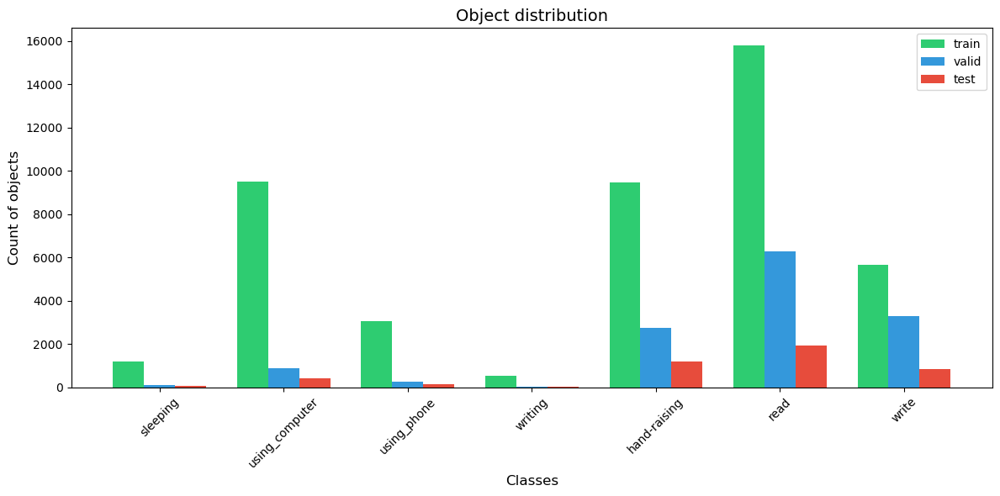


Hiển thị ảnh mẫu:


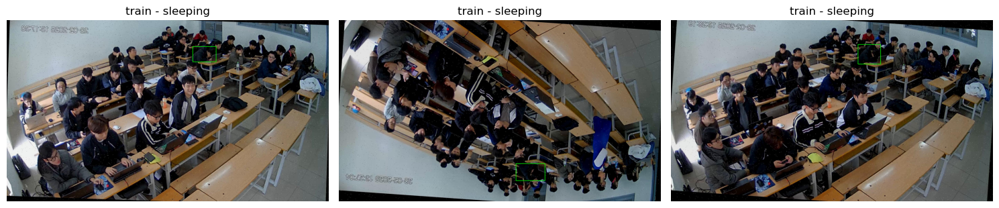

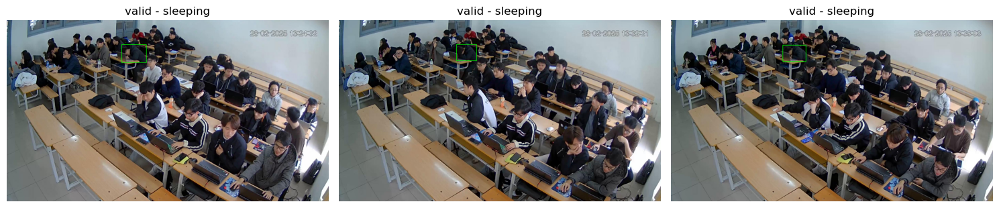

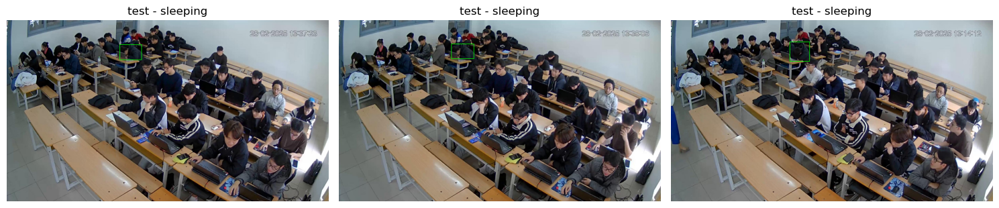

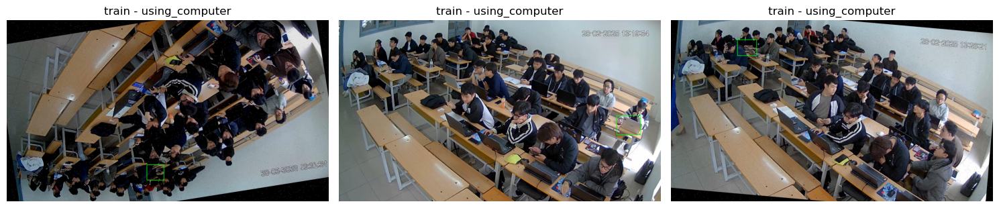

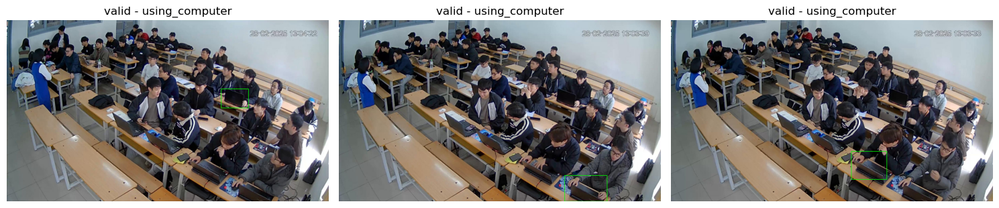

...

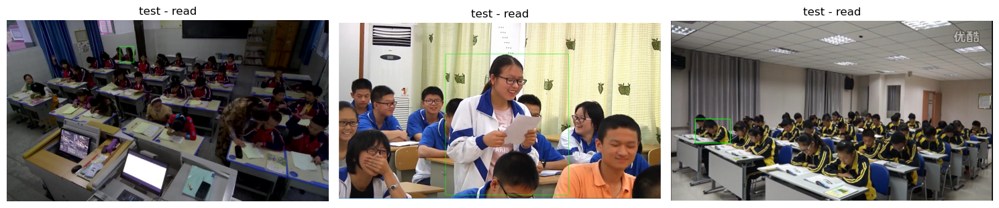

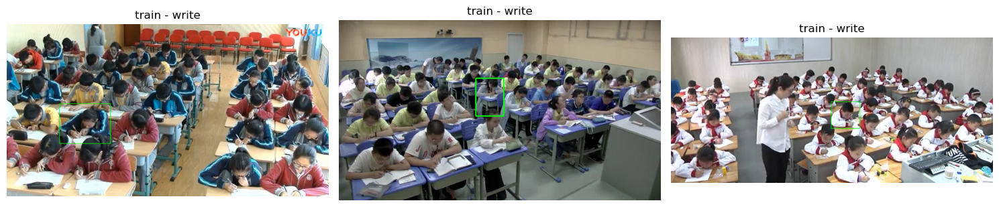

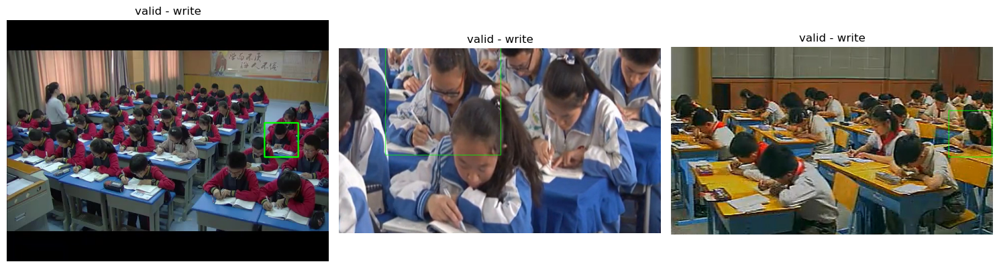

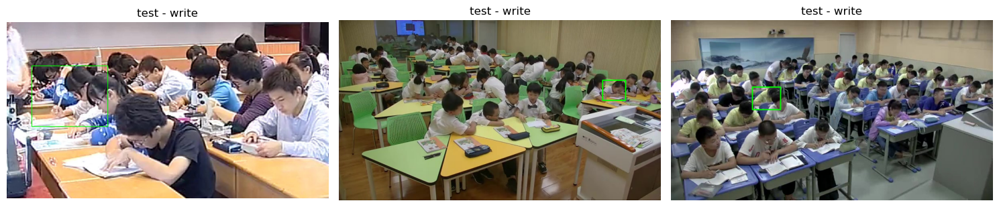

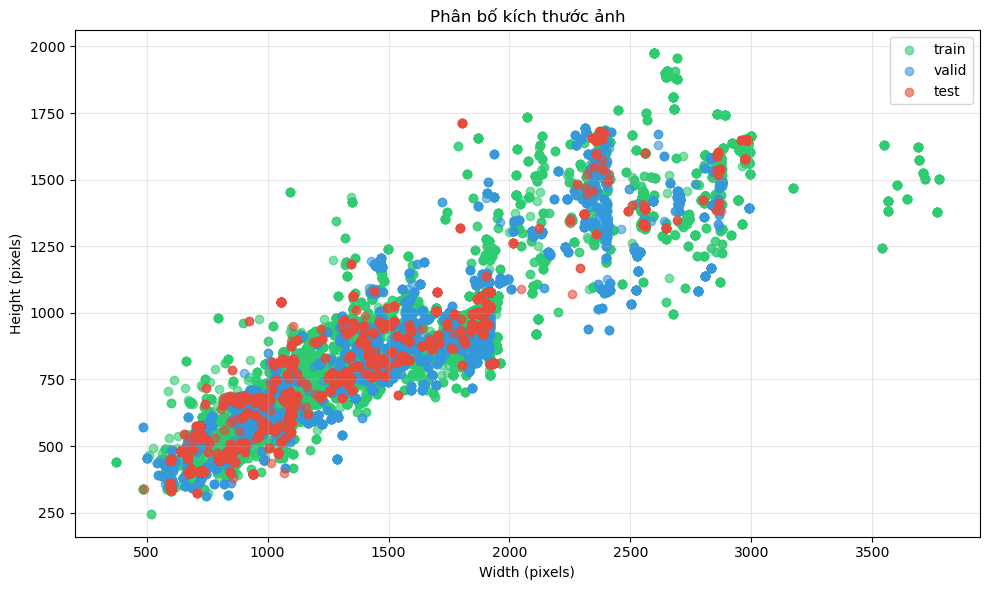


Thống kê chi tiết:

=== TRAIN ===

Class: using_computer
- Count: 9531
- Mean of size: 1880x1059

Class: using_phone
- Count: 3086
- Mean of size: 1880x1059

Class: hand-raising
- Count: 9479
- Mean of size: 1425x848

Class: sleeping
- Count: 1214
- Mean of size: 1880x1059

Class: write
- Count: 5666
- Mean of size: 1114x641

Class: read
- Count: 15817
- Mean of size: 1193x687

Class: writing
- Count: 543
- Mean of size: 1880x1059

Tổng số objects: 45336

=== VALID ===

Class: read
- Count: 6309
- Mean of size: 1139x683

Class: write
- Count: 3308
- Mean of size: 1057x624

Class: hand-raising
- Count: 2769
- Mean of size: 1244x744

Class: using_computer
- Count: 886
- Mean of size: 1880x1059

Class: using_phone
- Count: 279
- Mean of size: 1880x1059

Class: sleeping
- Count: 113
- Mean of size: 1880x1059

Class: writing
- Count: 54
- Mean of size: 1880x1059

Tổng số objects: 13718

=== TEST ===

Class: hand-raising
- Count: 1205
- Mean of size: 1360x823

Class: using_phone
- Count: 14

In [10]:
import os
import yaml
from collections import defaultdict
from PIL import Image
import matplotlib.pyplot as plt
import cv2
import random
import seaborn as sns
import numpy as np

def analyze_dataset(yaml_path):
    # 1. Đọc và in thông tin YAML
    print("1. Đọc file YAML:")
    with open(yaml_path, 'r') as f:
        data = yaml.safe_load(f)
    # print(f"Nội dung YAML: {data}")

    root_path = os.path.dirname(yaml_path)
    class_names = data['names']
    print(f"\nClasses: {class_names}")

    # 2. Kiểm tra cấu trúc thư mục
    print("\n2. Cấu trúc thư mục:")
    print(f"Root path: {root_path}")
    print("Nội dung root:")
    print(os.listdir(root_path))

    # 3. Thu thập thống kê
    stats = {
        'train': defaultdict(lambda: {'count': 0, 'sizes': [], 'examples': []}),
        'valid': defaultdict(lambda: {'count': 0, 'sizes': [], 'examples': []}),
        'test': defaultdict(lambda: {'count': 0, 'sizes': [], 'examples': []})
    }

    for split in ['train', 'valid', 'test']:
        images_dir = os.path.join(root_path, split, 'images')
        labels_dir = os.path.join(root_path, split, 'labels')

        # print(f"\nXử lý {split} set:")
        # print(f"Images dir: {images_dir}")
        # print(f"Labels dir: {labels_dir}")

        if not os.path.exists(images_dir) or not os.path.exists(labels_dir):
            print(f"Không tìm thấy thư mục images hoặc labels cho {split}")
            continue

        # In mẫu nội dung labels
        label_files = os.listdir(labels_dir)
        if label_files:
            print("\nMẫu nội dung labels:")
            for label_file in label_files[:2]:
                # print(f"\nFile: {label_file}")
                with open(os.path.join(labels_dir, label_file), 'r') as f:
                    print(f.read())

        # Xử lý từng ảnh
        for img_file in os.listdir(images_dir):
            if img_file.endswith(('.jpg', '.jpeg', '.png')):
                img_path = os.path.join(images_dir, img_file)
                label_path = os.path.join(labels_dir, img_file.rsplit('.', 1)[0] + '.txt')

                if os.path.exists(label_path):
                    try:
                        img = cv2.imread(img_path)
                        if img is None:
                            print(f"Không thể đọc ảnh: {img_path}")
                            continue
                        height, width = img.shape[:2]

                        with open(label_path, 'r') as f:
                            label_content = f.read().strip()
                            if label_content:
                                for line in label_content.split('\n'):
                                    try:
                                        parts = line.strip().split()
                                        if len(parts) == 5:
                                            class_id = int(parts[0])
                                            if class_id < len(class_names):
                                                class_name = class_names[class_id]
                                                stats[split][class_name]['count'] += 1
                                                stats[split][class_name]['sizes'].append((width, height))
                                                stats[split][class_name]['examples'].append((img_path, line))
                                        # else:
                                        #     # print(f"Format label không đúng: {line}")
                                    except ValueError as e:
                                        print(f"Lỗi parse label: {str(e)}")
                    except Exception as e:
                        print(f"Lỗi xử lý {img_path}: {str(e)}")

    # 4. Visualize kết quả
    # 4.1 Biểu đồ số lượng objects
    plt.figure(figsize=(12, 6))
    splits = list(stats.keys())
    x = np.arange(len(class_names))
    width = 0.25

    colors = ['#2ecc71', '#3498db', '#e74c3c']
    for i, (split, color) in enumerate(zip(splits, colors)):
        counts = [stats[split][class_name]['count'] for class_name in class_names]
        plt.bar(x + i*width, counts, width, label=split, color=color)

    plt.xlabel('Classes', fontsize=12)
    plt.ylabel('Count of objects', fontsize=12)
    plt.title('Object distribution', fontsize=14)
    plt.xticks(x + width, class_names, rotation=45)
    plt.legend()
    plt.tight_layout()
    plt.show()

    # 4.2 Hiển thị ảnh mẫu
    def plot_samples(split, class_name, num_samples=3):
        examples = stats[split][class_name]['examples']
        if not examples:
            return

        samples = random.sample(examples, min(num_samples, len(examples)))
        fig, axes = plt.subplots(1, len(samples), figsize=(15, 5))
        if len(samples) == 1:
            axes = [axes]

        for ax, (img_path, label) in zip(axes, samples):
            img = cv2.imread(img_path)
            if img is None:
                print(f"Không thể đọc ảnh: {img_path}")
                continue

            img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
            height, width = img.shape[:2]

            try:
                parts = label.strip().split()
                if len(parts) == 5:
                    _, x_center, y_center, w, h = map(float, parts)

                    x1 = int((x_center - w/2) * width)
                    y1 = int((y_center - h/2) * height)
                    x2 = int((x_center + w/2) * width)
                    y2 = int((y_center + h/2) * height)

                    cv2.rectangle(img, (x1, y1), (x2, y2), (0, 255, 0), 2)
            except Exception as e:
                print(f"Lỗi vẽ bbox: {str(e)}")

            ax.imshow(img)
            ax.axis('off')
            ax.set_title(f'{split} - {class_name}')

        plt.tight_layout()
        plt.show()

    print("\nHiển thị ảnh mẫu:")
    for class_name in class_names:
        for split in splits:
            if stats[split][class_name]['count'] > 0:
                plot_samples(split, class_name)

    # 4.3 Biểu đồ kích thước ảnh
    plt.figure(figsize=(10, 6))
    for split, color in zip(splits, colors):
        all_sizes = []
        for class_name in class_names:
            all_sizes.extend(stats[split][class_name]['sizes'])
        if all_sizes:
            widths, heights = zip(*all_sizes)
            plt.scatter(widths, heights, alpha=0.6, label=split, color=color)

    plt.xlabel('Width (pixels)')
    plt.ylabel('Height (pixels)')
    plt.title('Phân bố kích thước ảnh')
    plt.legend()
    plt.grid(True, alpha=0.3)
    plt.tight_layout()
    plt.show()

    # 5. In thống kê chi tiết
    print("\nThống kê chi tiết:")
    for split in stats:
        print(f"\n=== {split.upper()} ===")
        total = 0
        for class_name in stats[split]:
            count = stats[split][class_name]['count']
            sizes = stats[split][class_name]['sizes']
            total += count

            if count > 0:
                avg_width = np.mean([s[0] for s in sizes])
                avg_height = np.mean([s[1] for s in sizes])
                print(f"\nClass: {class_name}")
                print(f"- Count: {count}")
                print(f"- Mean of size: {avg_width:.0f}x{avg_height:.0f}")

        print(f"\nTổng số objects: {total}")
analyze_dataset(data_yaml_path)

#### Thống kê kích thước, diện tích và giá trị ngoại lai labeling

✅ Đã đọc cấu hình từ /hdd2/minhnv/CodingYOLOv12/Dataset/Student-Behavior-Recognition-6/data.yaml
📦 Số lớp: 7 - Tên lớp: ['sleeping', 'using_computer', 'using_phone', 'writing', 'hand-raising', 'read', 'write']


/tmp/ipykernel_189559/3606155555.py:140: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  bplot = plt.boxplot(all_data, labels=x_labels, showfliers=True, patch_artist=True)
Locator attempting to generate 1574 ticks ([-216000.0, ..., 4503000.0]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 1574 ticks ([-216000.0, ..., 4503000.0]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 1574 ticks ([-216000.0, ..., 4503000.0]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 1574 ticks ([-216000.0, ..., 4503000.0]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 1574 ticks ([-216000.0, ..., 4503000.0]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 1574 ticks ([-216000.0, ..., 4503000.0]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 15

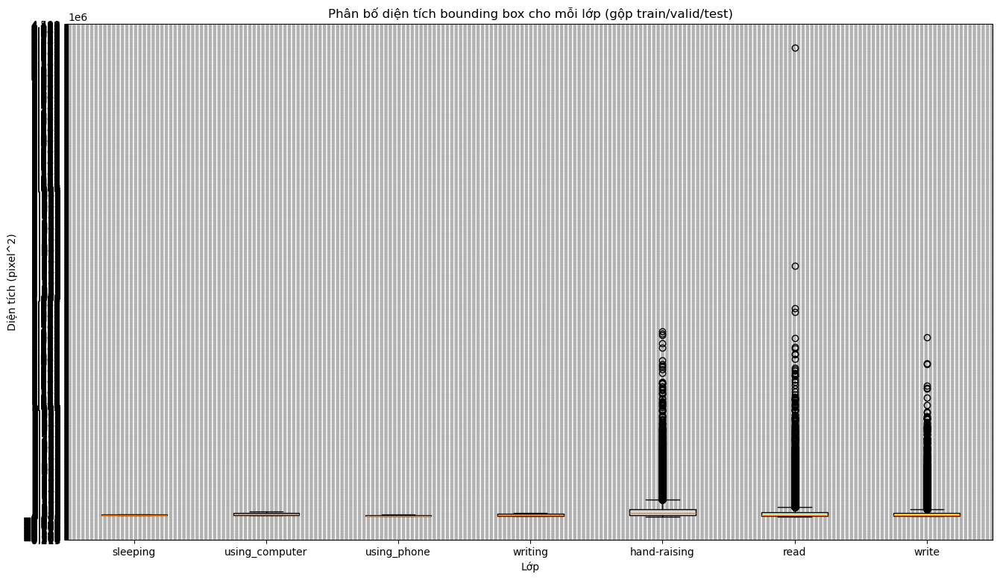


📈 BÁO CÁO CHI TIẾT

🔍 TRAIN

🏷️ Lớp: sleeping
   - Số lượng: 1214
   - Chiều rộng (px):
     Min: 92.0 | Max: 178.5
     Trung bình: 133.7 | Median: 134.0
   - Chiều cao (px):
     Min: 75.5 | Max: 145.0
     Trung bình: 104.5 | Median: 104.5
   - Diện tích (px²):
     Min: 11000.0 | Max: 17496.0
     Trung bình: 13925.7
   - Label không hợp lệ: 0

🏷️ Lớp: using_computer
   - Số lượng: 9531
   - Chiều rộng (px):
     Min: 76.0 | Max: 404.0
     Trung bình: 161.3 | Median: 156.0
   - Chiều cao (px):
     Min: 40.0 | Max: 253.5
     Trung bình: 132.5 | Median: 130.5
   - Diện tích (px²):
     Min: 8003.0 | Max: 43000.0
     Trung bình: 22165.6
   - Label không hợp lệ: 0

🏷️ Lớp: using_phone
   - Số lượng: 3086
   - Chiều rộng (px):
     Min: 42.5 | Max: 166.5
     Trung bình: 87.0 | Median: 84.0
   - Chiều cao (px):
     Min: 40.0 | Max: 154.0
     Trung bình: 82.6 | Median: 80.0
   - Diện tích (px²):
     Min: 3008.0 | Max: 15933.0
     Trung bình: 7467.8
   - Label không hợp lệ: 0

🏷️

In [8]:
import os
import yaml
import cv2
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import random
import math
from collections import defaultdict

def analyze_dataset(yaml_path):
    """Phân tích dataset YOLO với các tính năng:
    - Kiểm tra label hợp lệ
    - Thống kê kích thước bounding box
    - Phát hiện bất thường
    - Trực quan hóa dữ liệu
    """
    
    # 1. Đọc file cấu hình YAML
    with open(yaml_path, 'r') as f:
        data = yaml.safe_load(f)
    root_dir = os.path.dirname(yaml_path)
    class_names = data['names']
    print(f"✅ Đã đọc cấu hình từ {yaml_path}")
    print(f"📦 Số lớp: {len(class_names)} - Tên lớp: {class_names}")

    # 2. Khởi tạo cấu trúc lưu trữ thống kê
    stats = {
        split: {
            cls: {
                'count': 0,
                'widths': [],
                'heights': [],
                'areas': [],
                'examples': [],
                'invalid': 0
            } for cls in class_names
        } for split in ['train', 'valid', 'test']
    }

    # 3. Duyệt qua các tập dữ liệu
    for split in ['train', 'valid', 'test']:
        img_dir = os.path.join(root_dir, split, 'images')
        label_dir = os.path.join(root_dir, split, 'labels')

        if not os.path.exists(img_dir):
            print(f"⛔ Thiếu thư mục ảnh {split}")
            continue

        # 4. Xử lý từng ảnh
        for img_file in os.listdir(img_dir):
            if not img_file.lower().endswith(('.png', '.jpg', '.jpeg')):
                continue

            img_path = os.path.join(img_dir, img_file)
            label_path = os.path.join(label_dir, os.path.splitext(img_file)[0] + '.txt')

            if not os.path.exists(label_path):
                continue

            try:
                # 5. Đọc kích thước ảnh
                img = cv2.imread(img_path)
                if img is None:
                    print(f"❌ Không đọc được ảnh: {img_path}")
                    continue
                img_h, img_w = img.shape[:2]

                # 6. Xử lý từng label
                with open(label_path, 'r') as f:
                    for line in f:
                        line = line.strip()
                        if not line:
                            continue

                        parts = line.split()
                        # 7. Validate định dạng label
                        if len(parts) != 5:
                            stats[split][class_names[0]]['invalid'] += 1  # Giả định lớp đầu tiên cho lỗi
                            continue

                        try:
                            # 8. Chuyển đổi và kiểm tra tọa độ
                            class_id, xc, yc, w, h = map(float, parts)
                            if not (0 <= xc <= 1 and 0 <= yc <= 1 and 0 <= w <= 1 and 0 <= h <= 1):
                                stats[split][class_names[int(class_id)]]['invalid'] += 1
                                continue

                            # 9. Tính toán kích thước thực tế
                            box_w = w * img_w
                            box_h = h * img_h
                            area = box_w * box_h

                            # 10. Cập nhật thống kê
                            cls_name = class_names[int(class_id)]
                            stats[split][cls_name]['count'] += 1
                            stats[split][cls_name]['widths'].append(box_w)
                            stats[split][cls_name]['heights'].append(box_h)
                            stats[split][cls_name]['areas'].append(area)
                            stats[split][cls_name]['examples'].append(img_path)

                        except (ValueError, IndexError) as e:
                            print(f"Lỗi xử lý label: {str(e)}")
                            continue

            except Exception as e:
                print(f"Lỗi xử lý ảnh {img_path}: {str(e)}")

    # 11. Phân tích và hiển thị kết quả
    # _visualize_distributions(stats, class_names)
    visualize_single_plot(stats, class_names)
    
    _generate_report(stats, class_names)

import matplotlib.pyplot as plt
import numpy as np
import matplotlib.ticker as ticker

def visualize_single_plot(stats, classes, tick_interval=3000):
    """
    Vẽ boxplot trên một biểu đồ duy nhất để xem phân bố diện tích bounding box
    của mỗi lớp (gộp train/valid/test). Trục y được cấu hình hiển thị các giá trị
    dày đặc hơn với tick tự động (theo khoảng đơn vị tính toán từ dữ liệu).
    """
    all_data = []
    x_labels = []
    
    # Gộp diện tích bounding box của từng lớp từ các tập train, valid, test
    for cls in classes:
        areas = []
        for split in ['train', 'valid', 'test']:
            areas.extend(stats[split][cls]['areas'])
        if areas:
            all_data.append(areas)
            x_labels.append(cls)
    
    
    # Tạo figure và vẽ boxplot
    plt.figure(figsize=(16, 9))
    bplot = plt.boxplot(all_data, labels=x_labels, showfliers=True, patch_artist=True)
    colors = plt.cm.Set3(np.linspace(0, 1, len(all_data)))
    for patch, color in zip(bplot['boxes'], colors):
        patch.set_facecolor(color)
    
    plt.title("Phân bố diện tích bounding box cho mỗi lớp (gộp train/valid/test)")
    plt.xlabel("Lớp")
    plt.ylabel("Diện tích (pixel^2)")
    
    # Cấu hình trục y: thiết lập tick cách nhau mỗi tick_interval đơn vị
    ax = plt.gca()
    ax.yaxis.set_major_locator(ticker.MultipleLocator(tick_interval))
    ax.grid(True, axis='y', linestyle='--', alpha=0.7)
    plt.show()
def _generate_report(stats, classes):
    """Tạo báo cáo chi tiết"""
    print("\n📈 BÁO CÁO CHI TIẾT")
    
    for split in ['train', 'valid', 'test']:
        print(f"\n🔍 {split.upper()}")
        total = 0
        
        for cls in classes:
            cls_stats = stats[split][cls]
            if cls_stats['count'] == 0:
                continue
                
            # Tính các chỉ số thống kê
            widths = cls_stats['widths']
            heights = cls_stats['heights']
            areas = cls_stats['areas']
            
            report = {
                'count': cls_stats['count'],
                'width': {
                    'min': np.min(widths),
                    'max': np.max(widths),
                    'mean': np.mean(widths),
                    'median': np.median(widths)
                },
                'height': {
                    'min': np.min(heights),
                    'max': np.max(heights),
                    'mean': np.mean(heights),
                    'median': np.median(heights)
                },
                'area': {
                    'min': np.min(areas),
                    'max': np.max(areas),
                    'mean': np.mean(areas)
                },
                'invalid': cls_stats['invalid']
            }

            # In báo cáo
            print(f"\n🏷️ Lớp: {cls}")
            print(f"   - Số lượng: {report['count']}")
            print(f"   - Chiều rộng (px):")
            print(f"     Min: {report['width']['min']:.1f} | Max: {report['width']['max']:.1f}")
            print(f"     Trung bình: {report['width']['mean']:.1f} | Median: {report['width']['median']:.1f}")
            print(f"   - Chiều cao (px):")
            print(f"     Min: {report['height']['min']:.1f} | Max: {report['height']['max']:.1f}")
            print(f"     Trung bình: {report['height']['mean']:.1f} | Median: {report['height']['median']:.1f}")
            print(f"   - Diện tích (px²):")
            print(f"     Min: {report['area']['min']:.1f} | Max: {report['area']['max']:.1f}")
            print(f"     Trung bình: {report['area']['mean']:.1f}")
            print(f"   - Label không hợp lệ: {report['invalid']}")

            total += report['count']
        
        print(f"\nTổng số objects: {total}")

# Chạy chương trình
if __name__ == "__main__":
    analyze_dataset(data_yaml_path)

### 2.2.1 Bỏ qua giá trị diện tích min -> max

✅ Đã đọc cấu hình từ /hdd2/minhnv/CodingYOLOv12/Dataset/Student-Behavior-Recognition-6/data.yaml
📦 Số lớp: 6 - Tên lớp: ['drinking', 'raising_hand', 'sleeping', 'using_computer', 'using_phone', 'writing']
Bỏ label using_computer: 3 0.38138297872340426 0.8408876298394712 0.149468085106383 0.20113314447592068 (diện tích = 59853.0 không trong khoảng [8000, 43000])
Bỏ label using_computer: 3 0.4973404255319149 0.14589235127478753 0.059042553191489364 0.06043437204910293 (diện tích = 7104.0 không trong khoảng [8000, 43000])
Đã copy file không hợp lệ: 13_05_00-13_10_00-M-0-0-0-_frame_0026_png.rf.63835b6c5bb004981769a77172e0d88e.jpg
Bỏ label using_computer: 3 0.6771276595744681 0.7223796033994334 0.1800531914893617 0.32011331444759206 (diện tích = 114751.5 không trong khoảng [8000, 43000])
Bỏ label using_computer: 3 0.8127659574468085 0.8583569405099151 0.24707446808510639 0.28328611898017 (diện tích = 139350.0 không trong khoảng [8000, 43000])
Bỏ label using_computer: 3 0.5178191489361702 0.

The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.


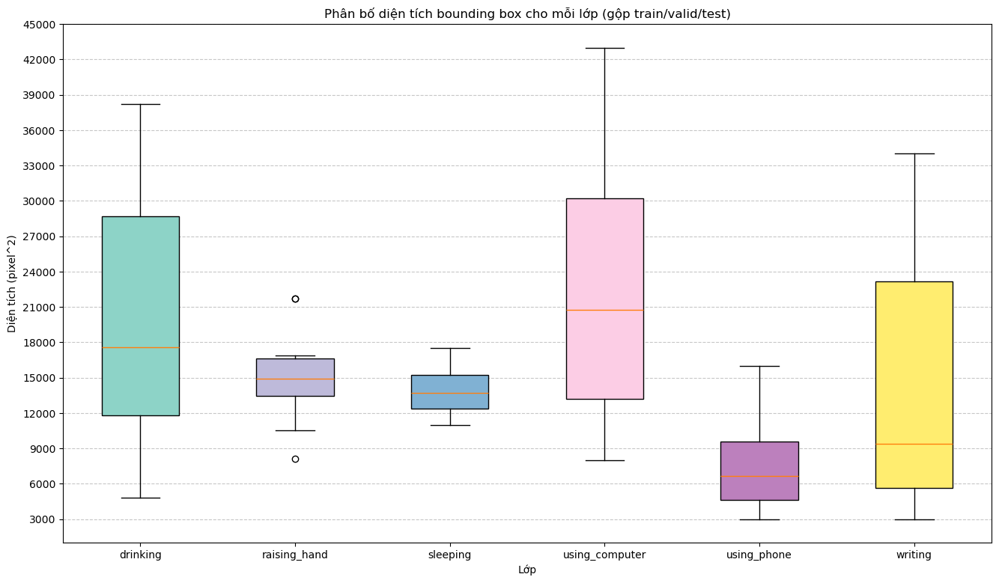


📈 BÁO CÁO CHI TIẾT

🔍 TRAIN

🏷️ Lớp: drinking
   - Số lượng: 45
   - Chiều rộng (px):
     Min: 60.5 | Max: 177.0
     Trung bình: 126.8 | Median: 130.0
   - Chiều cao (px):
     Min: 77.0 | Max: 227.0
     Trung bình: 157.4 | Median: 153.0
   - Diện tích (px²):
     Min: 4840.0 | Max: 38232.0
     Trung bình: 20766.5
   - Label không hợp lệ (trong quá trình xử lý): 0

🏷️ Lớp: raising_hand
   - Số lượng: 12
   - Chiều rộng (px):
     Min: 76.0 | Max: 161.0
     Trung bình: 116.5 | Median: 113.0
   - Chiều cao (px):
     Min: 115.5 | Max: 148.0
     Trung bình: 136.6 | Median: 137.0
   - Diện tích (px²):
     Min: 10526.0 | Max: 21735.0
     Trung bình: 15808.6
   - Label không hợp lệ (trong quá trình xử lý): 0

🏷️ Lớp: sleeping
   - Số lượng: 1214
   - Chiều rộng (px):
     Min: 92.0 | Max: 178.5
     Trung bình: 133.7 | Median: 134.0
   - Chiều cao (px):
     Min: 75.5 | Max: 145.0
     Trung bình: 104.5 | Median: 104.5
   - Diện tích (px²):
     Min: 11000.0 | Max: 17496.0
     Trun

In [39]:
import os
import yaml
import cv2
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import random
import shutil
from collections import defaultdict
import math
import matplotlib.ticker as ticker

def filter_labels_in_file(label_path, img_w, img_h, class_names, allowed_area_range):
    """
    Đọc file label, loại bỏ các dòng có bounding box không hợp lệ hoặc ngoài khoảng diện tích cho phép.
    Trả về:
      - valid_lines: danh sách các dòng hợp lệ sau khi lọc.
      - had_invalid: True nếu có ít dòng hợp lệ hơn so với ban đầu (tức có dòng bị loại bỏ).
      - removed_count: số dòng đã bị loại bỏ.
    """
    with open(label_path, 'r') as f:
        lines = f.readlines()
    
    valid_lines = []
    original_valid_count = 0  # Đếm các dòng không rỗng ban đầu
    for line in lines:
        line = line.strip()
        if not line:
            continue
        original_valid_count += 1
        parts = line.split()
        # Kiểm tra định dạng label: phải có 5 thành phần
        if len(parts) != 5:
            print(f"Bỏ qua label không hợp lệ: {line}")
            continue
        
        try:
            class_id, xc, yc, w, h = map(float, parts)
            # Kiểm tra giá trị chuẩn (normalized [0,1])
            if not (0 <= xc <= 1 and 0 <= yc <= 1 and 0 <= w <= 1 and 0 <= h <= 1):
                print(f"Bỏ qua label có giá trị ngoài [0,1]: {line}")
                continue
            
            box_w = w * img_w
            box_h = h * img_h
            area = box_w * box_h
            cls_name = class_names[int(class_id)]
            
            # Nếu lớp có quy định khoảng diện tích, kiểm tra và lọc
            if cls_name in allowed_area_range:
                min_area, max_area = allowed_area_range[cls_name]
                if area < min_area or area > max_area:
                    print(f"Bỏ label {cls_name}: {line} (diện tích = {area:.1f} không trong khoảng [{min_area}, {max_area}])")
                    continue
            
            # Nếu thỏa mãn các điều kiện, giữ lại label này
            valid_lines.append(line)
            
        except Exception as e:
            print(f"Lỗi xử lý label {line}: {str(e)}")
            continue
    
    # Xác định xem có dòng nào bị loại bỏ hay không và tính số dòng bị loại bỏ
    removed_count = original_valid_count - len(valid_lines)
    had_invalid = removed_count > 0

    # Ghi đè file label với các dòng hợp lệ
    with open(label_path, 'w') as f:
        if valid_lines:
            f.write("\n".join(valid_lines) + "\n")
        else:
            f.write("")
    
    return valid_lines, had_invalid, removed_count

def move_invalid_file(img_path, label_path, invalid_folder):
    """
    Copy ảnh và file label có chứa dữ liệu không hợp lệ (sau khi lọc) sang folder invalid_folder.
    Folder invalid_folder sẽ có cấu trúc con: 'images' và 'labels'
    """
    invalid_img_folder = os.path.join(invalid_folder, 'images')
    invalid_label_folder = os.path.join(invalid_folder, 'labels')
    os.makedirs(invalid_img_folder, exist_ok=True)
    os.makedirs(invalid_label_folder, exist_ok=True)
    
    shutil.copy(img_path, os.path.join(invalid_img_folder, os.path.basename(img_path)))
    shutil.copy(label_path, os.path.join(invalid_label_folder, os.path.basename(label_path)))
    print(f"Đã copy file không hợp lệ: {os.path.basename(img_path)}")

def analyze_dataset(yaml_path, allowed_area_range=None, invalid_output_dir=None):
    """
    Phân tích dataset YOLO với các tính năng:
      - Kiểm tra label hợp lệ và lọc label dựa trên diện tích (nếu được chỉ định)
      - Trích xuất file ảnh/label có chứa label không hợp lệ hoặc ngoài diện tích sang folder riêng
      - Thống kê kích thước bounding box, trực quan hóa dữ liệu và tạo báo cáo,
        bao gồm thống kê số lượng label bị loại bỏ ở mỗi folder.
    """
    # 1. Đọc file cấu hình YAML
    with open(yaml_path, 'r') as f:
        data = yaml.safe_load(f)
    root_dir = os.path.dirname(yaml_path)
    class_names = data['names']
    print(f"✅ Đã đọc cấu hình từ {yaml_path}")
    print(f"📦 Số lớp: {len(class_names)} - Tên lớp: {class_names}")

    # Nếu chưa có đường dẫn folder chứa file không hợp lệ, đặt mặc định là trong root_dir
    if invalid_output_dir is None:
        invalid_output_dir = os.path.join(root_dir, 'invalid_files')

    # 2. Khởi tạo cấu trúc lưu trữ thống kê
    stats = {
        split: {
            cls: {
                'count': 0,
                'widths': [],
                'heights': [],
                'areas': [],
                'examples': [],
                'invalid': 0
            } for cls in class_names
        } for split in ['train', 'valid', 'test']
    }
    
    # Khởi tạo thống kê số label bị loại bỏ cho từng folder
    removed_counts = {'train': 0, 'valid': 0, 'test': 0}

    # Nếu không truyền allowed_area_range thì đặt mặc định là rỗng (không lọc theo diện tích)
    if allowed_area_range is None:
        allowed_area_range = {}

    # 3. Duyệt qua các tập dữ liệu
    for split in ['train', 'valid', 'test']:
        img_dir = os.path.join(root_dir, split, 'images')
        label_dir = os.path.join(root_dir, split, 'labels')

        if not os.path.exists(img_dir):
            print(f"⛔ Thiếu thư mục ảnh {split}")
            continue

        # 4. Xử lý từng ảnh
        for img_file in os.listdir(img_dir):
            if not img_file.lower().endswith(('.png', '.jpg', '.jpeg')):
                continue

            img_path = os.path.join(img_dir, img_file)
            label_path = os.path.join(label_dir, os.path.splitext(img_file)[0] + '.txt')

            if not os.path.exists(label_path):
                continue

            try:
                # 5. Đọc kích thước ảnh
                img = cv2.imread(img_path)
                if img is None:
                    print(f"❌ Không đọc được ảnh: {img_path}")
                    continue
                img_h, img_w = img.shape[:2]

                # 6. Lọc label trong file
                valid_label_lines, had_invalid, removed_in_file = filter_labels_in_file(
                    label_path, img_w, img_h, class_names, allowed_area_range)
                
                # Cộng dồn số label bị loại bỏ cho split hiện tại
                removed_counts[split] += removed_in_file
                
                # Nếu có label không hợp lệ hoặc bị loại bỏ, copy ảnh & label sang folder invalid
                if had_invalid:
                    move_invalid_file(img_path, label_path, invalid_output_dir)

                # 7. Xử lý từng label đã được lọc (chỉ xử lý các dòng còn lại)
                with open(label_path, 'r') as f:
                    for line in f:
                        line = line.strip()
                        if not line:
                            continue

                        parts = line.split()
                        if len(parts) != 5:
                            stats[split][class_names[0]]['invalid'] += 1  # Giả định lớp đầu tiên cho lỗi
                            continue

                        try:
                            class_id, xc, yc, w, h = map(float, parts)
                            if not (0 <= xc <= 1 and 0 <= yc <= 1 and 0 <= w <= 1 and 0 <= h <= 1):
                                stats[split][class_names[int(class_id)]]['invalid'] += 1
                                continue

                            # 8. Tính toán kích thước thực tế
                            box_w = w * img_w
                            box_h = h * img_h
                            area = box_w * box_h

                            # 9. Cập nhật thống kê
                            cls_name = class_names[int(class_id)]
                            stats[split][cls_name]['count'] += 1
                            stats[split][cls_name]['widths'].append(box_w)
                            stats[split][cls_name]['heights'].append(box_h)
                            stats[split][cls_name]['areas'].append(area)
                            stats[split][cls_name]['examples'].append(img_path)

                        except (ValueError, IndexError) as e:
                            print(f"Lỗi xử lý label: {str(e)}")
                            continue

            except Exception as e:
                print(f"Lỗi xử lý ảnh {img_path}: {str(e)}")

    # 10. Trực quan hóa kết quả
    visualize_single_plot(stats, class_names)
    _generate_report(stats, class_names, removed_counts)

def visualize_single_plot(stats, classes, tick_interval=3000):
    """
    Vẽ boxplot trên một biểu đồ duy nhất để xem phân bố diện tích bounding box
    của mỗi lớp (gộp train/valid/test). Trục y được cấu hình hiển thị các giá trị
    dày đặc hơn với tick cách nhau mỗi tick_interval đơn vị.
    """
    all_data = []
    x_labels = []
    
    # Gộp diện tích bounding box của từng lớp từ các tập train, valid, test
    for cls in classes:
        areas = []
        for split in ['train', 'valid', 'test']:
            areas.extend(stats[split][cls]['areas'])
        if areas:
            all_data.append(areas)
            x_labels.append(cls)
    
    # Tạo figure và vẽ boxplot
    plt.figure(figsize=(16, 9))
    bplot = plt.boxplot(all_data, labels=x_labels, showfliers=True, patch_artist=True)
    colors = plt.cm.Set3(np.linspace(0, 1, len(all_data)))
    for patch, color in zip(bplot['boxes'], colors):
        patch.set_facecolor(color)
    
    plt.title("Phân bố diện tích bounding box cho mỗi lớp (gộp train/valid/test)")
    plt.xlabel("Lớp")
    plt.ylabel("Diện tích (pixel^2)")
    
    # Cấu hình trục y: thiết lập tick cách nhau mỗi tick_interval đơn vị
    ax = plt.gca()
    ax.yaxis.set_major_locator(ticker.MultipleLocator(tick_interval))
    ax.grid(True, axis='y', linestyle='--', alpha=0.7)
    plt.show()

def _generate_report(stats, classes, removed_counts):
    """Tạo báo cáo chi tiết, bao gồm số lượng label bị loại bỏ theo từng folder"""
    print("\n📈 BÁO CÁO CHI TIẾT")
    
    for split in ['train', 'valid', 'test']:
        print(f"\n🔍 {split.upper()}")
        total = 0
        
        for cls in classes:
            cls_stats = stats[split][cls]
            if cls_stats['count'] == 0:
                continue
                
            widths = cls_stats['widths']
            heights = cls_stats['heights']
            areas = cls_stats['areas']
            
            report = {
                'count': cls_stats['count'],
                'width': {
                    'min': np.min(widths),
                    'max': np.max(widths),
                    'mean': np.mean(widths),
                    'median': np.median(widths)
                },
                'height': {
                    'min': np.min(heights),
                    'max': np.max(heights),
                    'mean': np.mean(heights),
                    'median': np.median(heights)
                },
                'area': {
                    'min': np.min(areas),
                    'max': np.max(areas),
                    'mean': np.mean(areas)
                },
                'invalid': cls_stats['invalid']
            }

            print(f"\n🏷️ Lớp: {cls}")
            print(f"   - Số lượng: {report['count']}")
            print(f"   - Chiều rộng (px):")
            print(f"     Min: {report['width']['min']:.1f} | Max: {report['width']['max']:.1f}")
            print(f"     Trung bình: {report['width']['mean']:.1f} | Median: {report['width']['median']:.1f}")
            print(f"   - Chiều cao (px):")
            print(f"     Min: {report['height']['min']:.1f} | Max: {report['height']['max']:.1f}")
            print(f"     Trung bình: {report['height']['mean']:.1f} | Median: {report['height']['median']:.1f}")
            print(f"   - Diện tích (px²):")
            print(f"     Min: {report['area']['min']:.1f} | Max: {report['area']['max']:.1f}")
            print(f"     Trung bình: {report['area']['mean']:.1f}")
            print(f"   - Label không hợp lệ (trong quá trình xử lý): {report['invalid']}")
            
            total += report['count']
        
        print(f"\nTổng số objects trong {split}: {total}")
        print(f"Số label bị loại bỏ trong {split}: {removed_counts[split]}")

# Ví dụ gọi hàm với cấu hình YAML, quy định khoảng diện tích cho các lớp
if __name__ == "__main__":
    allowed_area_range = {
        "Drinking": (10000, 30000),
        "raising_hand": (8000, 25000),
        "sleeping": (11000, 17500),
        "using_computer": (8000, 43000),
        "using_phone": (3000, 16000),
        "writing": (3000, 34000)
    }
    # Ghi file ảnh/label không hợp lệ vào folder "invalid_files" trong thư mục gốc của dataset
    analyze_dataset(data_yaml_path, allowed_area_range, invalid_output_dir=None)


### 2.3 Export label wrong out folder ( StaticModels/yolov12s09032025_ver-dataset2/_ver1/invalid )

✅ Đã export 49 ảnh lỗi vào: /home/minhnv/Documents/ntt/AiIot/FinalPorject/CodingYOLOv12/StaticModels/yolov12s13032025_093107_ver-dataset6/_ver1/invalid_label
✅ Báo cáo chi tiết: /home/minhnv/Documents/ntt/AiIot/FinalPorject/CodingYOLOv12/StaticModels/yolov12s13032025_093107_ver-dataset6/_ver1/invalid_report.txt


/tmp/ipykernel_468001/485317831.py:147: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=reasons, y=counts, palette="viridis")


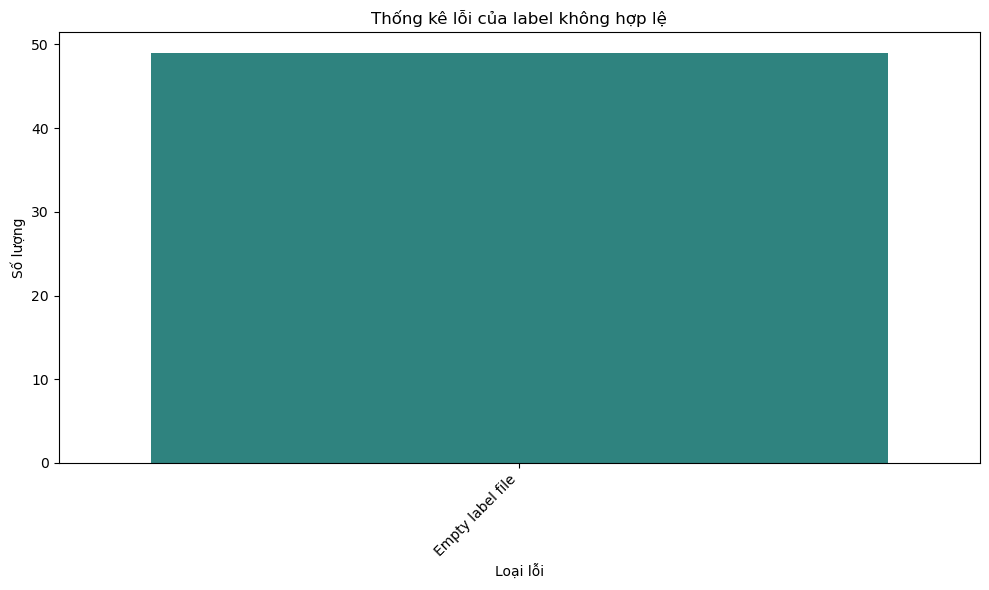

Đã xóa ảnh: /hdd2/minhnv/CodingYOLOv12/Dataset/Student-Behavior-Recognition-6/train/images/13_10_00-13_15_00-M-0-0-0-_frame_0195_png.rf.7b8aac66f6c98a6f175e14b04219a7f4.jpg
Đã xóa ảnh: /hdd2/minhnv/CodingYOLOv12/Dataset/Student-Behavior-Recognition-6/train/images/13_15_00-13_20_00-M-0-0-0-_frame_0039_png.rf.41a4e1e06a989373eb40e02a38a22e51.jpg
Đã xóa ảnh: /hdd2/minhnv/CodingYOLOv12/Dataset/Student-Behavior-Recognition-6/train/images/13_15_00-13_20_00-M-0-0-0-_frame_0279_png.rf.177fc9c25823657e68f22ae7b5f45542.jpg
Đã xóa ảnh: /hdd2/minhnv/CodingYOLOv12/Dataset/Student-Behavior-Recognition-6/train/images/13_10_00-13_15_00-M-0-0-0-_frame_0208_png.rf.a56b6f69594eb2b8e8423a06e50f3d90.jpg
Đã xóa ảnh: /hdd2/minhnv/CodingYOLOv12/Dataset/Student-Behavior-Recognition-6/train/images/13_10_00-13_15_00-M-0-0-0-_frame_0195_png.rf.0a334f10cba2ec85ab7060c18935edcc.jpg
Đã xóa ảnh: /hdd2/minhnv/CodingYOLOv12/Dataset/Student-Behavior-Recognition-6/train/images/13_10_00-13_15_00-M-0-0-0-_frame_0181_png.rf

In [28]:
import os
import shutil
import yaml
from collections import defaultdict
import matplotlib.pyplot as plt
import seaborn as sns

def export_invalid_labels(yaml_path, output_dir):
    """
    Export các ảnh và label không hợp lệ vào thư mục riêng và tạo báo cáo chi tiết.
    
    Ý tưởng:
    1. Đọc cấu hình dataset từ file YAML để lấy danh sách các lớp.
    2. Tạo các thư mục output cho ảnh và label hợp lệ (clean) và không hợp lệ (invalid).
    3. Duyệt qua các tập dữ liệu (train, valid, test), kiểm tra từng file label.
       - Nếu file label không tồn tại hoặc nội dung không hợp lệ (sai định dạng, lỗi chuyển đổi, 
         tọa độ hoặc class ID không hợp lệ), ghi lại lỗi.
    4. Nếu một ảnh có label không hợp lệ, copy ảnh và file label (nếu tồn tại) sang thư mục invalid.
    5. Ghi báo cáo chi tiết các lỗi vào file text.
    6. Trả về report chứa thông tin thống kê để có thể dùng cho việc trực quan hóa sau này.
    """
    # 1. Đọc cấu hình dataset từ file YAML
    with open(yaml_path, 'r') as f:
        data = yaml.safe_load(f)
    root_dir = os.path.dirname(yaml_path)
    class_names = data['names']
    
    # 2. Tạo thư mục output cho label không hợp lệ (invalid_label)
    invalid_dir = os.path.join(output_dir, 'invalid_label')
    os.makedirs(os.path.join(invalid_dir, 'images'), exist_ok=True)
    os.makedirs(os.path.join(invalid_dir, 'labels'), exist_ok=True)
    
    # Khởi tạo report thống kê
    report = {
        'total_images': 0,      # Tổng số ảnh được kiểm tra
        'invalid_images': 0,    # Số ảnh có label không hợp lệ
        'details': []           # Chi tiết lỗi của từng ảnh: { 'image': ..., 'reasons': [list of errors] }
    }
    
    # 3. Duyệt qua các tập dữ liệu: train, valid, test
    for split in ['train', 'valid', 'test']:
        img_dir = os.path.join(root_dir, split, 'images')
        label_dir = os.path.join(root_dir, split, 'labels')
        
        if not os.path.exists(img_dir):
            continue
            
        # 4. Xử lý từng ảnh trong tập dữ liệu
        for img_file in os.listdir(img_dir):
            report['total_images'] += 1  # Cập nhật tổng số ảnh
            img_path = os.path.join(img_dir, img_file)
            label_path = os.path.join(label_dir, os.path.splitext(img_file)[0] + '.txt')
            
            invalid_reasons = []  # Danh sách lỗi cho ảnh hiện tại
            
            # 5. Kiểm tra file label
            if not os.path.exists(label_path):
                invalid_reasons.append('Missing label file')
            else:
                with open(label_path, 'r') as f:
                    lines = f.readlines()
                    # Nếu file label trống
                    if not lines:
                        invalid_reasons.append('Empty label file')
                    
                    # Duyệt từng dòng label
                    for line_idx, line in enumerate(lines, 1):
                        line = line.strip()
                        parts = line.split()
                        
                        # Kiểm tra định dạng: phải có đúng 5 giá trị
                        if len(parts) != 5:
                            invalid_reasons.append(f'Line {line_idx}: Invalid format')
                            continue
                            
                        try:
                            # Chuyển đổi các giá trị sang float
                            class_id, xc, yc, w, h = map(float, parts)
                            # Kiểm tra tọa độ và kích thước phải nằm trong khoảng [0, 1]
                            if not (0 <= xc <= 1 and 0 <= yc <= 1 and 0 <= w <= 1 and 0 <= h <= 1):
                                invalid_reasons.append(f'Line {line_idx}: Invalid coordinates')
                            
                            # Kiểm tra class ID hợp lệ (không vượt quá số lượng lớp)
                            if int(class_id) >= len(class_names):
                                invalid_reasons.append(f'Line {line_idx}: Invalid class ID {class_id}')
                                
                        except ValueError:
                            invalid_reasons.append(f'Line {line_idx}: Conversion error')
            
            # 6. Nếu có lỗi, copy ảnh và file label vào thư mục invalid và cập nhật báo cáo
            if invalid_reasons:
                report['invalid_images'] += 1  # Tăng số lượng ảnh lỗi
                # Copy ảnh sang thư mục invalid
                shutil.copy(img_path, os.path.join(invalid_dir, 'images', img_file))
                # Copy file label (nếu tồn tại)
                if os.path.exists(label_path):
                    shutil.copy(label_path, os.path.join(invalid_dir, 'labels', os.path.basename(label_path)))
                
                # Lưu chi tiết lỗi vào báo cáo
                report['details'].append({
                    'image': img_path,
                    'reasons': invalid_reasons
                })
    
    # 7. Ghi báo cáo chi tiết vào file text
    report_file = os.path.join(output_dir, 'invalid_report.txt')
    with open(report_file, 'w') as f:
        f.write(f"Tổng số ảnh đã kiểm tra: {report['total_images']}\n")
        f.write(f"Số ảnh có label không hợp lệ: {report['invalid_images']}\n\n")
        f.write("Chi tiết các lỗi:\n")
        for entry in report['details']:
            f.write(f"\nẢnh: {entry['image']}\n")
            for reason in entry['reasons']:
                f.write(f" - {reason}\n")
    
    print(f"✅ Đã export {report['invalid_images']} ảnh lỗi vào: {invalid_dir}")
    print(f"✅ Báo cáo chi tiết: {report_file}")
    
    # Trả về report để có thể dùng cho trực quan hóa sau này
    return report

def visualize_invalid_labels(report):
    """
    Trực quan hóa thống kê các lỗi của label không hợp lệ.
    
    Ý tưởng:
    1. Lặp qua các entry trong report['details'] để tính số lần xuất hiện của từng lỗi.
    2. Tạo danh sách các lỗi và số lượng tương ứng.
    3. Vẽ biểu đồ cột bằng seaborn để hiển thị thống kê lỗi.
    
    Đầu vào:
        report: Dictionary báo cáo được trả về từ hàm export_invalid_labels.
    """
    error_counts = defaultdict(int)  # Dictionary để lưu số lần xuất hiện của mỗi lỗi
    
    # Lặp qua từng ảnh trong report
    for entry in report['details']:
        for reason in entry['reasons']:
            error_counts[reason] += 1  # Tăng số đếm cho lỗi này
    
    # Chuyển dictionary error_counts thành danh sách để trực quan hóa
    reasons = list(error_counts.keys())
    counts = list(error_counts.values())
    
    # Vẽ biểu đồ cột sử dụng seaborn
    plt.figure(figsize=(10, 6))
    sns.barplot(x=reasons, y=counts, palette="viridis")
    plt.title("Thống kê lỗi của label không hợp lệ")
    plt.xlabel("Loại lỗi")
    plt.ylabel("Số lượng")
    plt.xticks(rotation=45, ha="right")
    plt.tight_layout()
    plt.show()
def delete_invalid_images(report):
    """
    Xóa các bức ảnh bị invalid_label khỏi thư mục gốc dựa trên báo cáo.
    
    Ý tưởng:
      - Lặp qua danh sách các ảnh có lỗi trong report['details'].
      - Xác định folder của ảnh đó (train, valid, hoặc test) dựa trên đường dẫn.
      - Nếu file ảnh tồn tại, xóa file và tăng bộ đếm theo folder.
      - Sau cùng, in ra tổng số ảnh đã xóa theo từng folder.
    """
    # Khởi tạo bộ đếm cho từng split
    deleted_counts = {"train": 0, "valid": 0, "test": 0}
    
    # Duyệt qua từng entry trong report
    for entry in report['details']:
        image_path = entry['image']
        try:
            if os.path.exists(image_path):
                os.remove(image_path)
                print(f"Đã xóa ảnh: {image_path}")
                # Phân tích đường dẫn để xác định folder (train, valid, test)
                path_parts = os.path.normpath(image_path).split(os.sep)
                # Tìm phần chứa "train", "valid" hoặc "test"
                for split in ["train", "valid", "test"]:
                    if split in path_parts:
                        deleted_counts[split] += 1
                        break
            else:
                print(f"Ảnh không tồn tại: {image_path}")
        except Exception as e:
            print(f"Lỗi khi xóa ảnh {image_path}: {e}")
    
    # In ra báo cáo thống kê số ảnh đã xóa theo folder
    print("\n=== Báo cáo xóa ảnh invalid ===")
    for split in ["train", "valid", "test"]:
        print(f"{split.capitalize()}: Đã xóa {deleted_counts[split]} ảnh")

# Sử dụng
output_directory = unique_save_path
# Gọi hàm export_invalid_labels để xuất các ảnh và label không hợp lệ, đồng thời tạo báo cáo chi tiết
report = export_invalid_labels(data_yaml_path, output_directory)

# Trực quan hóa thống kê lỗi dựa trên báo cáo thu được
visualize_invalid_labels(report)

# Xóa các ảnh bị invalid_label trong thư mục gốc
delete_invalid_images(report)


### 2.4 Vẽ bouding box ( Từ những file đã export ở trên )

✅ Đã export 0 ảnh lỗi vào: /home/minhnv/Documents/ntt/AiIot/FinalPorject/CodingYOLOv12/StaticModels/yolov12s13032025_093107_ver-dataset6/_ver1/invalid_label
✅ Báo cáo chi tiết: /home/minhnv/Documents/ntt/AiIot/FinalPorject/CodingYOLOv12/StaticModels/yolov12s13032025_093107_ver-dataset6/_ver1/invalid_report.txt


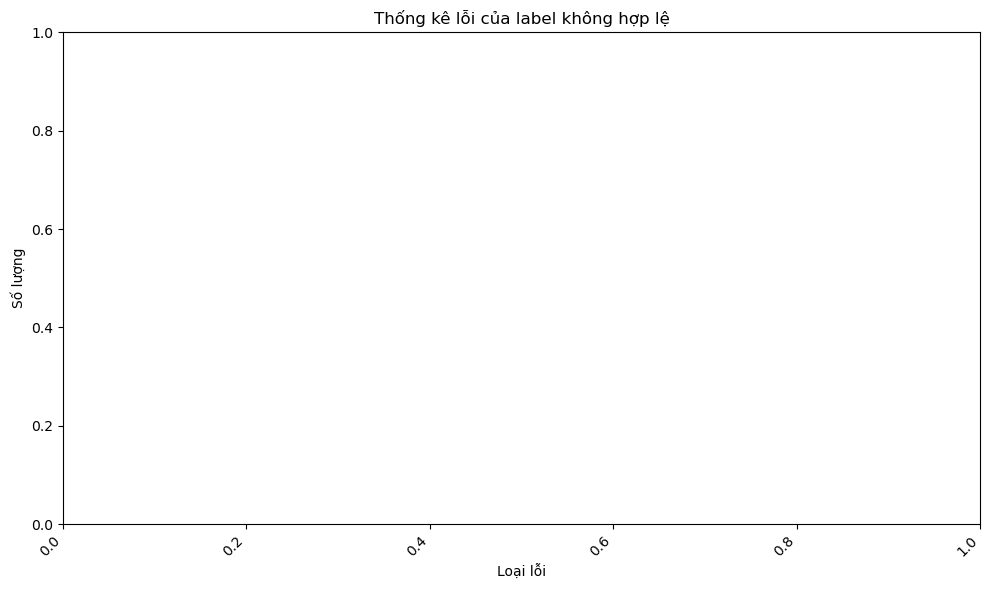

In [29]:
import os
import shutil
import yaml
from collections import defaultdict
import matplotlib.pyplot as plt
import seaborn as sns

def export_invalid_labels(yaml_path, output_dir):
    """
    Export các ảnh và label không hợp lệ vào thư mục riêng và tạo báo cáo chi tiết.
    
    Ý tưởng:
    1. Đọc cấu hình dataset từ file YAML để lấy danh sách các lớp.
    2. Tạo các thư mục output cho ảnh và label hợp lệ (clean) và không hợp lệ (invalid).
    3. Duyệt qua các tập dữ liệu (train, valid, test), kiểm tra từng file label.
       - Nếu file label không tồn tại hoặc nội dung không hợp lệ (sai định dạng, lỗi chuyển đổi, 
         tọa độ hoặc class ID không hợp lệ), ghi lại lỗi.
    4. Nếu một ảnh có label không hợp lệ, copy ảnh và file label (nếu tồn tại) sang thư mục invalid.
    5. Ghi báo cáo chi tiết các lỗi vào file text.
    6. Trả về report chứa thông tin thống kê để có thể dùng cho việc trực quan hóa sau này.
    """
    # 1. Đọc cấu hình dataset từ file YAML
    with open(yaml_path, 'r') as f:
        data = yaml.safe_load(f)
    root_dir = os.path.dirname(yaml_path)
    class_names = data['names']
    
    # 2. Tạo thư mục output cho label không hợp lệ (invalid_label)
    invalid_dir = os.path.join(output_dir, 'invalid_label')
    os.makedirs(os.path.join(invalid_dir, 'images'), exist_ok=True)
    os.makedirs(os.path.join(invalid_dir, 'labels'), exist_ok=True)
    
    # Khởi tạo report thống kê
    report = {
        'total_images': 0,      # Tổng số ảnh được kiểm tra
        'invalid_images': 0,    # Số ảnh có label không hợp lệ
        'details': []           # Chi tiết lỗi của từng ảnh: { 'image': ..., 'reasons': [list of errors] }
    }
    
    # 3. Duyệt qua các tập dữ liệu: train, valid, test
    for split in ['train', 'valid', 'test']:
        img_dir = os.path.join(root_dir, split, 'images')
        label_dir = os.path.join(root_dir, split, 'labels')
        
        if not os.path.exists(img_dir):
            continue
            
        # 4. Xử lý từng ảnh trong tập dữ liệu
        for img_file in os.listdir(img_dir):
            report['total_images'] += 1  # Cập nhật tổng số ảnh
            img_path = os.path.join(img_dir, img_file)
            label_path = os.path.join(label_dir, os.path.splitext(img_file)[0] + '.txt')
            
            invalid_reasons = []  # Danh sách lỗi cho ảnh hiện tại
            
            # 5. Kiểm tra file label
            if not os.path.exists(label_path):
                invalid_reasons.append('Missing label file')
            else:
                with open(label_path, 'r') as f:
                    lines = f.readlines()
                    # Nếu file label trống
                    if not lines:
                        invalid_reasons.append('Empty label file')
                    
                    # Duyệt từng dòng label
                    for line_idx, line in enumerate(lines, 1):
                        line = line.strip()
                        parts = line.split()
                        
                        # Kiểm tra định dạng: phải có đúng 5 giá trị
                        if len(parts) != 5:
                            invalid_reasons.append(f'Line {line_idx}: Invalid format')
                            continue
                            
                        try:
                            # Chuyển đổi các giá trị sang float
                            class_id, xc, yc, w, h = map(float, parts)
                            # Kiểm tra tọa độ và kích thước phải nằm trong khoảng [0, 1]
                            if not (0 <= xc <= 1 and 0 <= yc <= 1 and 0 <= w <= 1 and 0 <= h <= 1):
                                invalid_reasons.append(f'Line {line_idx}: Invalid coordinates')
                            
                            # Kiểm tra class ID hợp lệ (không vượt quá số lượng lớp)
                            if int(class_id) >= len(class_names):
                                invalid_reasons.append(f'Line {line_idx}: Invalid class ID {class_id}')
                                
                        except ValueError:
                            invalid_reasons.append(f'Line {line_idx}: Conversion error')
            
            # 6. Nếu có lỗi, copy ảnh và file label vào thư mục invalid và cập nhật báo cáo
            if invalid_reasons:
                report['invalid_images'] += 1  # Tăng số lượng ảnh lỗi
                # Copy ảnh sang thư mục invalid
                shutil.copy(img_path, os.path.join(invalid_dir, 'images', img_file))
                # Copy file label (nếu tồn tại)
                if os.path.exists(label_path):
                    shutil.copy(label_path, os.path.join(invalid_dir, 'labels', os.path.basename(label_path)))
                
                # Lưu chi tiết lỗi vào báo cáo
                report['details'].append({
                    'image': img_path,
                    'reasons': invalid_reasons
                })
    
    # 7. Ghi báo cáo chi tiết vào file text
    report_file = os.path.join(output_dir, 'invalid_report.txt')
    with open(report_file, 'w') as f:
        f.write(f"Tổng số ảnh đã kiểm tra: {report['total_images']}\n")
        f.write(f"Số ảnh có label không hợp lệ: {report['invalid_images']}\n\n")
        f.write("Chi tiết các lỗi:\n")
        for entry in report['details']:
            f.write(f"\nẢnh: {entry['image']}\n")
            for reason in entry['reasons']:
                f.write(f" - {reason}\n")
    
    print(f"✅ Đã export {report['invalid_images']} ảnh lỗi vào: {invalid_dir}")
    print(f"✅ Báo cáo chi tiết: {report_file}")
    
    # Trả về report để có thể dùng cho trực quan hóa sau này
    return report

def visualize_invalid_labels(report):
    """
    Trực quan hóa thống kê các lỗi của label không hợp lệ.
    
    Ý tưởng:
    1. Lặp qua các entry trong report['details'] để tính số lần xuất hiện của từng lỗi.
    2. Tạo danh sách các lỗi và số lượng tương ứng.
    3. Vẽ biểu đồ cột bằng seaborn để hiển thị thống kê lỗi.
    
    Đầu vào:
        report: Dictionary báo cáo được trả về từ hàm export_invalid_labels.
    """
    error_counts = defaultdict(int)  # Dictionary để lưu số lần xuất hiện của mỗi lỗi
    
    # Lặp qua từng ảnh trong report
    for entry in report['details']:
        for reason in entry['reasons']:
            error_counts[reason] += 1  # Tăng số đếm cho lỗi này
    
    # Chuyển dictionary error_counts thành danh sách để trực quan hóa
    reasons = list(error_counts.keys())
    counts = list(error_counts.values())
    
    # Vẽ biểu đồ cột sử dụng seaborn
    plt.figure(figsize=(10, 6))
    sns.barplot(x=reasons, y=counts, palette="viridis")
    plt.title("Thống kê lỗi của label không hợp lệ")
    plt.xlabel("Loại lỗi")
    plt.ylabel("Số lượng")
    plt.xticks(rotation=45, ha="right")
    plt.tight_layout()
    plt.show()

if __name__ == "__main__":
    # Cập nhật đường dẫn tới folder chứa ảnh, folder chứa label và folder export
    image_folder = f"{unique_save_path}/invalid_label/images"
    label_folder = f"{unique_save_path}/invalid_label/labels"
    output_folder = f"{unique_save_path}/invalid_label/visualize_images"
    
    # Gọi hàm export_invalid_labels để xuất các ảnh và label không hợp lệ, đồng thời tạo báo cáo chi tiết
    report = export_invalid_labels(data_yaml_path, output_directory)
    # Trực quan hóa thống kê lỗi dựa trên báo cáo thu được
    visualize_invalid_labels(report)

### 2.8 Thống kê số bức ảnh đã tăng cường, chỉnh sửa ngoại lai

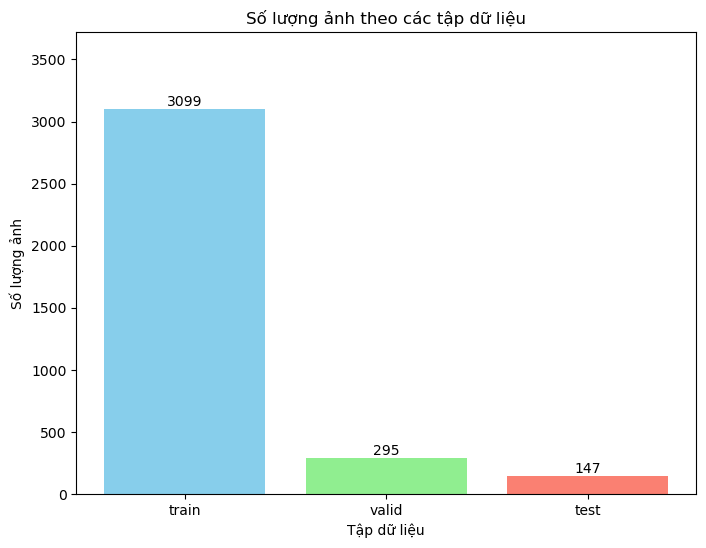

In [44]:
import os
import matplotlib.pyplot as plt

def count_images(root_dir):
    """
    Đếm số lượng ảnh trong các folder train, valid, test (trong thư mục con images).
    Trả về dictionary với số lượng ảnh cho mỗi split.
    """
    splits = ['train', 'valid', 'test']
    counts = {}
    
    for split in splits:
        img_dir = os.path.join(root_dir, split, 'images')
        if not os.path.exists(img_dir):
            print(f"Không tìm thấy thư mục: {img_dir}")
            counts[split] = 0
            continue
        
        # Lọc ra các file ảnh có phần mở rộng phù hợp
        images = [f for f in os.listdir(img_dir) if f.lower().endswith(('.png', '.jpg', '.jpeg'))]
        counts[split] = len(images)
    
    return counts

def visualize_image_counts(root_dir):
    """
    Hiển thị biểu đồ cột thống kê số lượng ảnh theo các tập dữ liệu.
    """
    counts = count_images(root_dir)
    splits = list(counts.keys())
    values = [counts[split] for split in splits]
    
    plt.figure(figsize=(8,6))
    bars = plt.bar(splits, values, color=['skyblue', 'lightgreen', 'salmon'])
    
    plt.title("Số lượng ảnh theo các tập dữ liệu")
    plt.xlabel("Tập dữ liệu")
    plt.ylabel("Số lượng ảnh")
    plt.ylim(0, max(values)*1.2)
    
    # Ghi nhãn số lượng lên trên từng cột
    for bar in bars:
        yval = bar.get_height()
        plt.text(bar.get_x() + bar.get_width()/2, yval + 1, int(yval), ha='center', va='bottom')
    
    plt.show()

if __name__ == '__main__':
    dataset_root = "/hdd2/minhnv/CodingYOLOv12/Dataset/Student-Behavior-Recognition-6"  # Cập nhật đường dẫn thư mục dataset của bạn
    visualize_image_counts(dataset_root)


### 2.9 Thống kê số lượng label sau khi đã xử lý loại bỏ

1. Đọc file YAML:

Classes: ['drinking', 'raising_hand', 'sleeping', 'using_computer', 'using_phone', 'writing']

2. Cấu trúc thư mục:
Root path: /hdd2/minhnv/CodingYOLOv12/Dataset/Student-Behavior-Recognition-6
Nội dung root:
['data.yaml', 'train', 'test', 'invalid_files', 'README.dataset.txt', 'README.roboflow.txt', 'valid']

Mẫu nội dung labels:
4 0.14893617021276595 0.6798866855524079 0.045744680851063826 0.08026440037771483
3 0.11303191489361702 0.7261567516525024 0.0601063829787234 0.0821529745042493
3 0.24202127659574468 0.7516525023607177 0.07287234042553191 0.07932011331444759
3 0.4877659574468085 0.8512747875354107 0.06914893617021277 0.07176581680830972
4 0.38776595744680853 0.4169027384324835 0.04042553191489362 0.07932011331444759
3 0.7093085106382979 0.5958451369216242 0.0925531914893617 0.12653446647780925
3 0.6289893617021277 0.6303116147308782 0.07553191489361702 0.10292728989612843

3 0.7452127659574468 0.37960339943342775 0.10638297872340426 0.18271954674220964


Mẫu

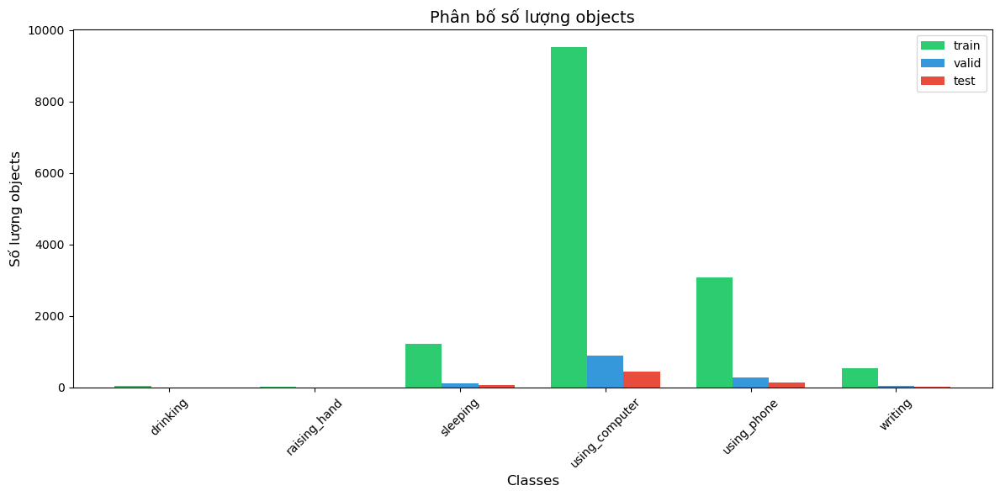


Hiển thị ảnh mẫu:


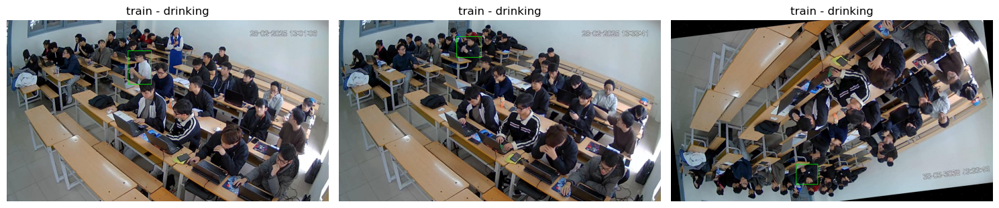

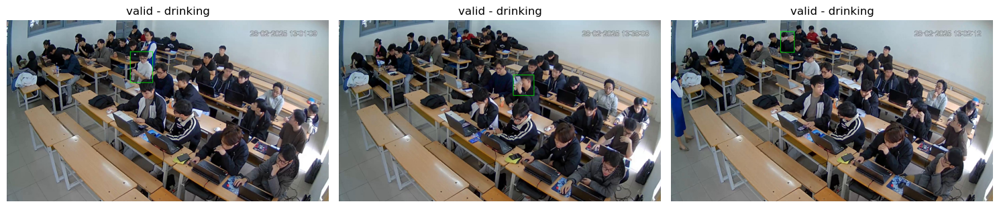

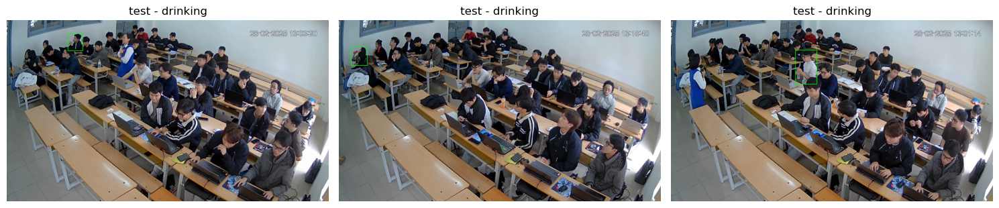

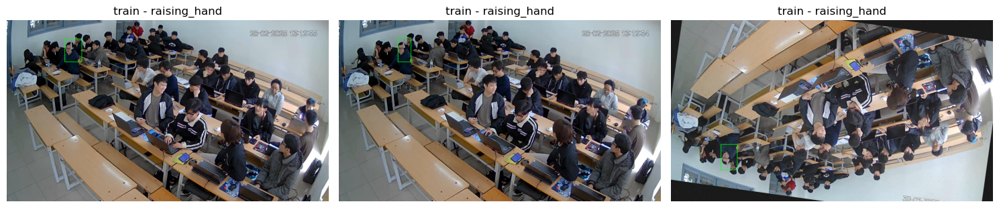

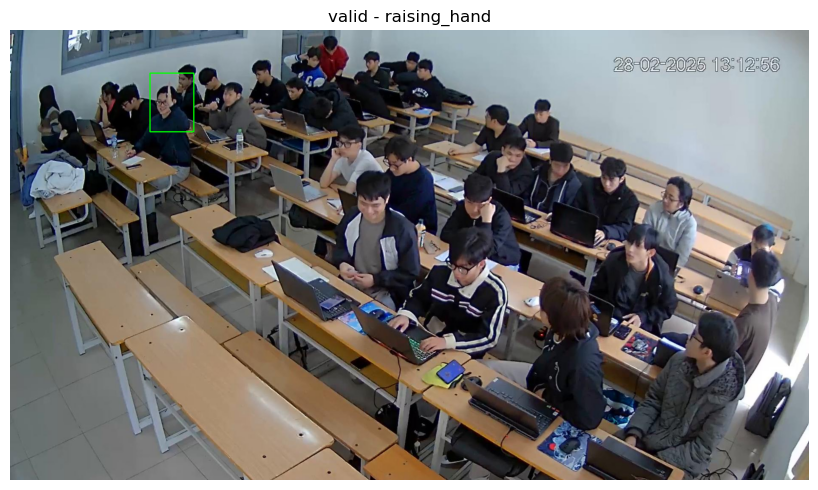

...

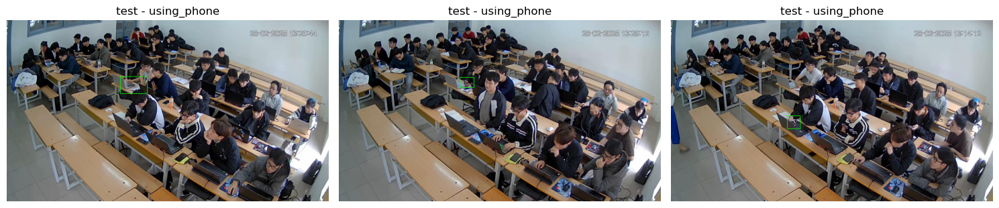

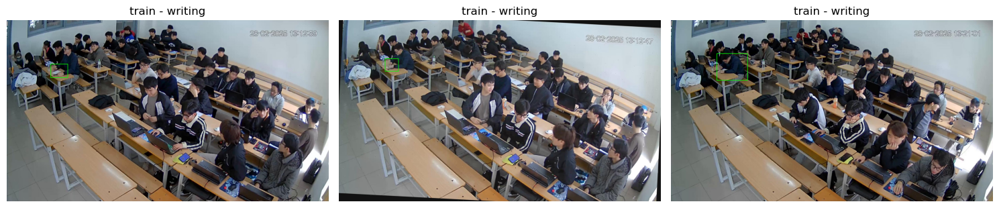

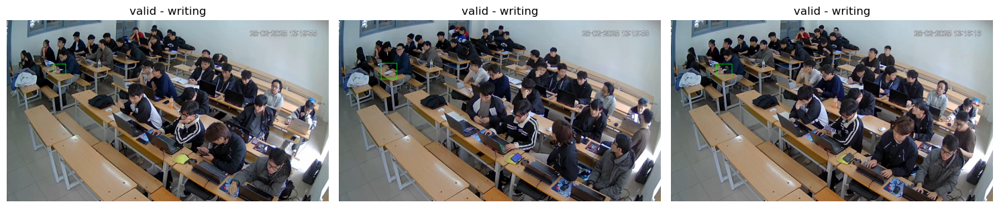

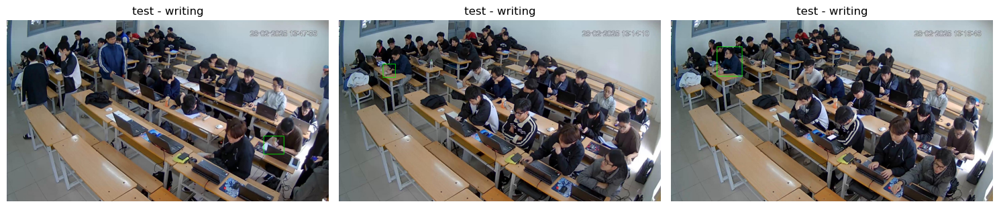

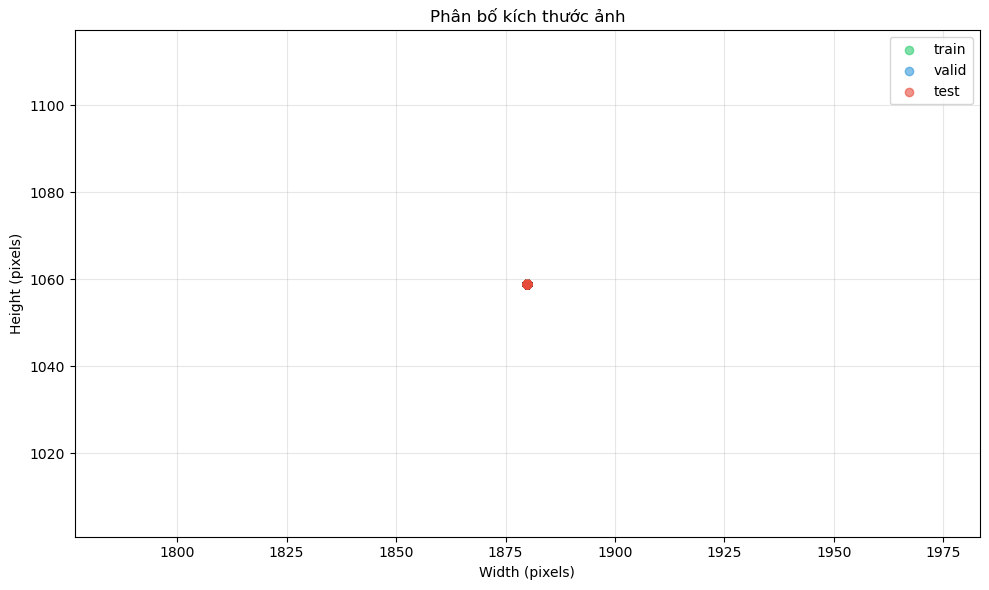


Thống kê chi tiết:

=== TRAIN ===

Class: using_computer
- Số lượng: 9531
- Kích thước trung bình: 1880x1059

Class: using_phone
- Số lượng: 3086
- Kích thước trung bình: 1880x1059

Class: sleeping
- Số lượng: 1214
- Kích thước trung bình: 1880x1059

Class: writing
- Số lượng: 543
- Kích thước trung bình: 1880x1059

Class: drinking
- Số lượng: 45
- Kích thước trung bình: 1880x1059

Class: raising_hand
- Số lượng: 12
- Kích thước trung bình: 1880x1059

Tổng số objects: 14431

=== VALID ===

Class: using_computer
- Số lượng: 886
- Kích thước trung bình: 1880x1059

Class: using_phone
- Số lượng: 279
- Kích thước trung bình: 1880x1059

Class: sleeping
- Số lượng: 113
- Kích thước trung bình: 1880x1059

Class: writing
- Số lượng: 54
- Kích thước trung bình: 1880x1059

Class: drinking
- Số lượng: 4
- Kích thước trung bình: 1880x1059

Class: raising_hand
- Số lượng: 1
- Kích thước trung bình: 1880x1059

Tổng số objects: 1337

=== TEST ===

Class: using_phone
- Số lượng: 146
- Kích thước trun

In [45]:
import os
import yaml
from collections import defaultdict
from PIL import Image
import matplotlib.pyplot as plt
import cv2
import random
import seaborn as sns
import numpy as np

def analyze_dataset(yaml_path):
    # 1. Đọc và in thông tin YAML
    print("1. Đọc file YAML:")
    with open(yaml_path, 'r') as f:
        data = yaml.safe_load(f)
    # print(f"Nội dung YAML: {data}")

    root_path = os.path.dirname(yaml_path)
    class_names = data['names']
    print(f"\nClasses: {class_names}")

    # 2. Kiểm tra cấu trúc thư mục
    print("\n2. Cấu trúc thư mục:")
    print(f"Root path: {root_path}")
    print("Nội dung root:")
    print(os.listdir(root_path))

    # 3. Thu thập thống kê
    stats = {
        'train': defaultdict(lambda: {'count': 0, 'sizes': [], 'examples': []}),
        'valid': defaultdict(lambda: {'count': 0, 'sizes': [], 'examples': []}),
        'test': defaultdict(lambda: {'count': 0, 'sizes': [], 'examples': []})
    }

    for split in ['train', 'valid', 'test']:
        images_dir = os.path.join(root_path, split, 'images')
        labels_dir = os.path.join(root_path, split, 'labels')

        # print(f"\nXử lý {split} set:")
        # print(f"Images dir: {images_dir}")
        # print(f"Labels dir: {labels_dir}")

        if not os.path.exists(images_dir) or not os.path.exists(labels_dir):
            print(f"Không tìm thấy thư mục images hoặc labels cho {split}")
            continue

        # In mẫu nội dung labels
        label_files = os.listdir(labels_dir)
        if label_files:
            print("\nMẫu nội dung labels:")
            for label_file in label_files[:2]:
                # print(f"\nFile: {label_file}")
                with open(os.path.join(labels_dir, label_file), 'r') as f:
                    print(f.read())

        # Xử lý từng ảnh
        for img_file in os.listdir(images_dir):
            if img_file.endswith(('.jpg', '.jpeg', '.png')):
                img_path = os.path.join(images_dir, img_file)
                label_path = os.path.join(labels_dir, img_file.rsplit('.', 1)[0] + '.txt')

                if os.path.exists(label_path):
                    try:
                        img = cv2.imread(img_path)
                        if img is None:
                            print(f"Không thể đọc ảnh: {img_path}")
                            continue
                        height, width = img.shape[:2]

                        with open(label_path, 'r') as f:
                            label_content = f.read().strip()
                            if label_content:
                                for line in label_content.split('\n'):
                                    try:
                                        parts = line.strip().split()
                                        if len(parts) == 5:
                                            class_id = int(parts[0])
                                            if class_id < len(class_names):
                                                class_name = class_names[class_id]
                                                stats[split][class_name]['count'] += 1
                                                stats[split][class_name]['sizes'].append((width, height))
                                                stats[split][class_name]['examples'].append((img_path, line))
                                        # else:
                                        #     # print(f"Format label không đúng: {line}")
                                    except ValueError as e:
                                        print(f"Lỗi parse label: {str(e)}")
                    except Exception as e:
                        print(f"Lỗi xử lý {img_path}: {str(e)}")

    # 4. Visualize kết quả
    # 4.1 Biểu đồ số lượng objects
    plt.figure(figsize=(12, 6))
    splits = list(stats.keys())
    x = np.arange(len(class_names))
    width = 0.25

    colors = ['#2ecc71', '#3498db', '#e74c3c']
    for i, (split, color) in enumerate(zip(splits, colors)):
        counts = [stats[split][class_name]['count'] for class_name in class_names]
        plt.bar(x + i*width, counts, width, label=split, color=color)

    plt.xlabel('Classes', fontsize=12)
    plt.ylabel('Số lượng objects', fontsize=12)
    plt.title('Phân bố số lượng objects', fontsize=14)
    plt.xticks(x + width, class_names, rotation=45)
    plt.legend()
    plt.tight_layout()
    plt.show()

    # 4.2 Hiển thị ảnh mẫu
    def plot_samples(split, class_name, num_samples=3):
        examples = stats[split][class_name]['examples']
        if not examples:
            return

        samples = random.sample(examples, min(num_samples, len(examples)))
        fig, axes = plt.subplots(1, len(samples), figsize=(15, 5))
        if len(samples) == 1:
            axes = [axes]

        for ax, (img_path, label) in zip(axes, samples):
            img = cv2.imread(img_path)
            if img is None:
                print(f"Không thể đọc ảnh: {img_path}")
                continue

            img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
            height, width = img.shape[:2]

            try:
                parts = label.strip().split()
                if len(parts) == 5:
                    _, x_center, y_center, w, h = map(float, parts)

                    x1 = int((x_center - w/2) * width)
                    y1 = int((y_center - h/2) * height)
                    x2 = int((x_center + w/2) * width)
                    y2 = int((y_center + h/2) * height)

                    cv2.rectangle(img, (x1, y1), (x2, y2), (0, 255, 0), 2)
            except Exception as e:
                print(f"Lỗi vẽ bbox: {str(e)}")

            ax.imshow(img)
            ax.axis('off')
            ax.set_title(f'{split} - {class_name}')

        plt.tight_layout()
        plt.show()

    print("\nHiển thị ảnh mẫu:")
    for class_name in class_names:
        for split in splits:
            if stats[split][class_name]['count'] > 0:
                plot_samples(split, class_name)

    # 4.3 Biểu đồ kích thước ảnh
    plt.figure(figsize=(10, 6))
    for split, color in zip(splits, colors):
        all_sizes = []
        for class_name in class_names:
            all_sizes.extend(stats[split][class_name]['sizes'])
        if all_sizes:
            widths, heights = zip(*all_sizes)
            plt.scatter(widths, heights, alpha=0.6, label=split, color=color)

    plt.xlabel('Width (pixels)')
    plt.ylabel('Height (pixels)')
    plt.title('Phân bố kích thước ảnh')
    plt.legend()
    plt.grid(True, alpha=0.3)
    plt.tight_layout()
    plt.show()

    # 5. In thống kê chi tiết
    print("\nThống kê chi tiết:")
    for split in stats:
        print(f"\n=== {split.upper()} ===")
        total = 0
        for class_name in stats[split]:
            count = stats[split][class_name]['count']
            sizes = stats[split][class_name]['sizes']
            total += count

            if count > 0:
                avg_width = np.mean([s[0] for s in sizes])
                avg_height = np.mean([s[1] for s in sizes])
                print(f"\nClass: {class_name}")
                print(f"- Số lượng: {count}")
                print(f"- Kích thước trung bình: {avg_width:.0f}x{avg_height:.0f}")

        print(f"\nTổng số objects: {total}")
analyze_dataset(data_yaml_path)